<a href="https://colab.research.google.com/github/luisamariarodriguez/F_monografia_esp_analitica_ciencia_datos_2024./blob/main/Code/020_Modelo_Brillo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# UNSUPERVISED ANOMALY SEGMENTATION
### This is a implementation of **DFR: Deep Feature Reconstruction for Unsupervised Anomaly Segmentation** https://arxiv.org/abs/2012.07122
#### We train only with OK images, and then we predict a hotmap, where high areas are presumably anomalous
#### The pretrained weights provided by me (input anomalysegmentation-weights) are not very good because Kaggle limits training time to 9hrs

## IMPORTS

In [ ]:
!pip install tqdm

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras import Input, Model, Sequential
from tensorflow.keras import layers

from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA

from skimage import io
from skimage.transform import resize

import numpy as np

from matplotlib import pyplot as plt
import matplotlib.pyplot as plt
import cv2

import random
import os
from tqdm import tqdm

from random import randrange

## Custom Data Generator

In [ ]:
input_directory = f"/content/drive/MyDrive/pixai-anomaly-detection"
input_directory_test = f"/content/drive/MyDrive/pixai-anomaly-detection/test"
classes = ['anomaly', 'good']

In [ ]:
input_model_filepath = "../input/anomalysegmentation-weights/anomaly-segmentation-model_vgg19.h5"
output_model_filepath = "./anomaly-segmentation-model.h5"

In [ ]:
class CustomDataGen(tf.keras.utils.Sequence):

    def __init__(self, path = input_directory,
                 batch_size = 4,
                 input_size=(224, 224),
                 shuffle=True, seed = None, subset = 'training'):

        self.image_data_generator = ImageDataGenerator(rescale=1. / 255, data_format='channels_last',
            #zoom_range = 0.1,
            #width_shift_range = 0.05,
            #height_shift_range = 0.05,
            #brightness_range=(0.95,1.05)
        )

        if seed is None:
            random.randint(0, 2**32)

        self.batch_size = batch_size
        self.input_size = input_size

        self.X_paths = [os.fsdecode(file) for file in os.scandir(f"{path}/train/good")]
        self.X_train, self.X_val = train_test_split(self.X_paths, test_size=0.2, random_state = seed, shuffle = True)

        if subset == 'training':
            self.X = self.X_train
        elif subset == 'validation':
            self.X = self.X_val

        self.n = len(self.X)


    def __getitem__(self, index):

        data_x = []

        for i in range(self.batch_size):
            image = cv2.imread(self.X[self.batch_size * index + i])

            image = self.image_data_generator.random_transform(image)

            image = image / 255

            image = tf.image.resize(image, self.input_size)
            data_x.append(image)

        data_x = np.array(data_x)

        return data_x, data_x

    def __len__(self):
        return self.n // self.batch_size

In [ ]:
INPUT_SIZE = (224,224)
seed = random.randint(0, 2**32)
train_datagen = CustomDataGen(input_size = INPUT_SIZE, batch_size = 4, seed = seed)
validation_datagen = CustomDataGen(input_size = INPUT_SIZE, subset = "validation", seed = seed)

In [ ]:
len(train_datagen)

21

In [ ]:
#Check we dont have the same images in train and validation sets
any([value in train_datagen.X for value in validation_datagen.X])

False

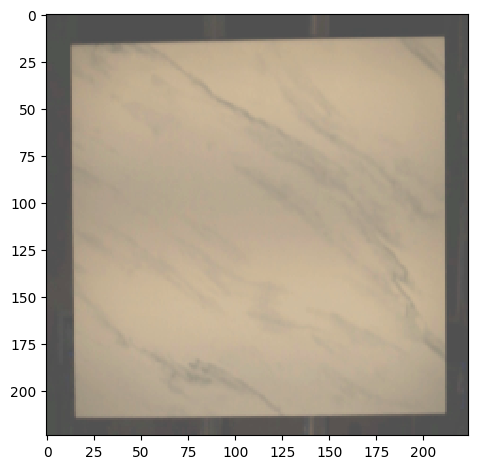

In [ ]:
x, y = train_datagen[0]
io.imshow(x[0])
io.show()

## Model

In [ ]:
#model class
#Implementation of DFR: Deep Feature Reconstruction for Unsupervised Anomaly Segmentation https://arxiv.org/abs/2012.07122
class AnomalySegmentator(tf.keras.Model):
    def __init__(self, init_layer = 0, end_layer = None):
        super(AnomalySegmentator, self).__init__()
        #self.L2_weight = 1e-6
        self.init_layer = init_layer
        self.end_layer = end_layer

    def build_autoencoder(self, c0, cd):
        self.autoencoder = Sequential([
            layers.InputLayer((self.map_shape[0]//4, self.map_shape[1]//4, c0)),
            layers.Conv2D((c0 + cd) // 2,(1,1), padding='same', activation = tf.keras.layers.LeakyReLU(alpha=0.1)),
            layers.Conv2D(2*cd,(1,1), padding='same', activation = tf.keras.layers.LeakyReLU(alpha=0.1)),
            layers.Conv2D(cd,(1,1), padding='same'),
            layers.Conv2D(2*cd,(1,1), padding='same', activation = tf.keras.layers.LeakyReLU(alpha=0.1)),
            layers.Conv2D((c0 + cd) // 2,(1,1), padding='same', activation = tf.keras.layers.LeakyReLU(alpha=0.1)),
            layers.Conv2D(c0,(1,1), padding='same')
        ])

    def build(self, input_shape):

        self.vgg = VGG19(include_top = False, weights = 'imagenet', input_shape=input_shape[1:])
        self.features_list = [layer.output for layer in self.vgg.layers if 'conv' in layer.name][self.init_layer:self.end_layer]

        self.feature_extractor = Model(inputs = self.vgg.input,
                                       outputs = self.features_list)
        self.feature_extractor.trainable = False

        self.threshold = tf.Variable(0, trainable = False, dtype = tf.float32)

        self.map_shape = self.features_list[0].shape[1:-1]

        self.average_pooling = layers.AveragePooling2D(pool_size=(4, 4), strides=(4,4))



        self.c0 = sum([feature.shape[-1] for feature in self.features_list])
        self.cd = 40
        self.build_autoencoder(self.c0, self.cd)


    def call(self, inputs):
        features = self.feature_extractor(inputs)
        resized_features = [tf.image.resize(feature, self.map_shape) for feature in features]
        resized_features = tf.concat(resized_features, axis = -1)

        resized_features = self.average_pooling(resized_features)

        autoencoder_output = self.autoencoder(resized_features)
        return tf.reduce_sum((autoencoder_output - resized_features)**2, axis = -1)

    def reconstruction_loss(self):
        @tf.function
        def _loss(y_true, y_pred):
            loss = tf.reduce_mean(y_pred, axis = (1,2)) / (tf.cast(tf.shape(y_pred)[0], tf.float32) * self.c0)
            return loss

        return _loss

    def compute_threshold(self, data_loader, fpr = 0.05):
      error = []
      for i in tqdm(range(len(data_loader))):
        x, y = data_loader[i]
        error.append(self(x))

      threshold = np.percentile(error, 100 - fpr)
      self.threshold = tf.Variable(threshold, trainable = False, dtype = tf.float32)

    def compute_pca(self, data_loader):
        extraction_per_sample = 20

        extractions = []
        for i in tqdm(range(len(data_loader))):
            x, _ = data_loader[i]

            features = self.feature_extractor(x)
            resized_features = [tf.image.resize(feature, self.map_shape) for feature in features]
            resized_features = tf.concat(resized_features, axis = -1)

            resized_features = self.average_pooling(resized_features)

            for feature in resized_features:

                for _ in range(extraction_per_sample):

                    row, col = randrange(feature.shape[0]), randrange(feature.shape[1])
                    extraction = feature[row, col]
                    extractions.append(extraction)

        extractions = np.array(extractions)
        print(f"Extractions Shape: {extractions.shape}")
        pca = PCA(0.9, svd_solver = "full")
        pca.fit(extractions)
        self.cd = pca.n_components_
        self.build_autoencoder(self.c0, self.cd)
        print(f"Components with explainable variance 0.9 -> {self.cd}")

In [ ]:
as_model = AnomalySegmentator()
as_model.compile(Adam(1e-4), loss = as_model.reconstruction_loss())

In [ ]:
as_model.build((None, *INPUT_SIZE,3))
as_model.compute_pca(train_datagen)

80134624/80134624 [==============================] - 5s 0us/step


100%|██████████| 21/21 [00:09<00:00,  2.29it/s]


Extractions Shape: (1680, 5504)
Components with explainable variance 0.9 -> 19


## Training

Epoch 1/70
21/21 [==============================] - 28s 452ms/step - loss: 7.1683 - val_loss: 2.7782 - lr: 1.0000e-04
Epoch 2/70
21/21 [==============================] - 10s 456ms/step - loss: 2.3382 - val_loss: 1.8582 - lr: 1.0000e-04
Epoch 3/70
21/21 [==============================] - 9s 451ms/step - loss: 1.6423 - val_loss: 1.3070 - lr: 1.0000e-04
Epoch 4/70
21/21 [==============================] - 10s 492ms/step - loss: 1.2553 - val_loss: 1.1175 - lr: 1.0000e-04
Epoch 5/70
21/21 [==============================] - 9s 451ms/step - loss: 1.0582 - val_loss: 0.9031 - lr: 1.0000e-04
Epoch 6/70
21/21 [==============================] - 10s 485ms/step - loss: 0.8265 - val_loss: 0.7087 - lr: 1.0000e-04
Epoch 7/70
21/21 [==============================] - 10s 500ms/step - loss: 0.6706 - val_loss: 0.5891 - lr: 1.0000e-04
Epoch 8/70
21/21 [==============================] - 10s 462ms/step - loss: 0.5591 - val_loss: 0.5102 - lr: 1.0000e-04
Epoch 9/70
21/21 [==============================] - 10s 49

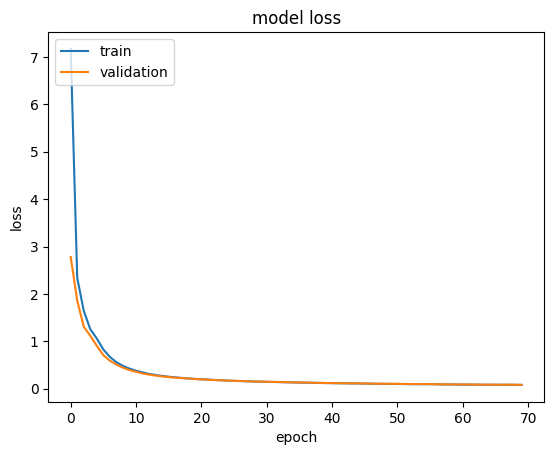

100%|██████████| 21/21 [00:07<00:00,  2.97it/s]


In [ ]:
#True if we want to train the model
if True:
    # Training the model
    plateau = tf.keras.callbacks.ReduceLROnPlateau(
      monitor='val_loss', factor=0.5, patience=5, verbose = 1
    )
    es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', verbose=1,
                                          patience=15)  # Early stopping (stops training when validation doesn't improve for {patience} epochs)
    save_best = tf.keras.callbacks.ModelCheckpoint(output_model_filepath, monitor='val_loss', save_best_only=True,
                                                mode='min', save_weights_only = True)  # Saves the best version of the model to disk (as measured on the validation data set)

    history = as_model.fit(train_datagen,
        epochs=70,
        validation_data=validation_datagen,
        shuffle=True,
        callbacks=[es, save_best, plateau])
    #Training history
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'validation'], loc='upper left')
    plt.show()

    as_model.load_weights(output_model_filepath)
    as_model.compute_threshold(train_datagen)
    as_model.save_weights(output_model_filepath)
else:

    as_model.build((None, *INPUT_SIZE,3))
    as_model.load_weights(input_model_filepath)
    as_model.compute_threshold(train_datagen)
    as_model.summary()
    as_model.autoencoder.summary()

# TESTING

Found 125 images belonging to 2 classes.


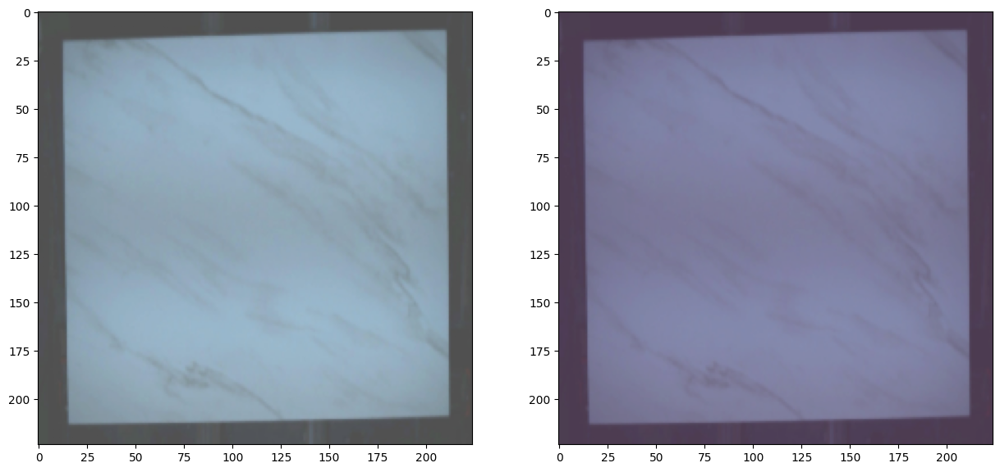

Threshold: 30895.55078125 MaxValue: 22928.10546875
Directory: good, Anomaly detected: False


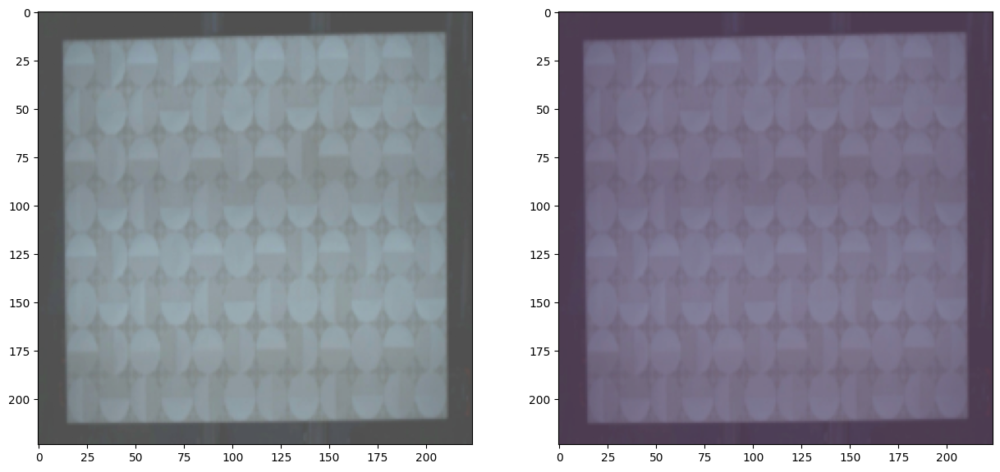

Threshold: 30895.55078125 MaxValue: 15822.142578125
Directory: good, Anomaly detected: False


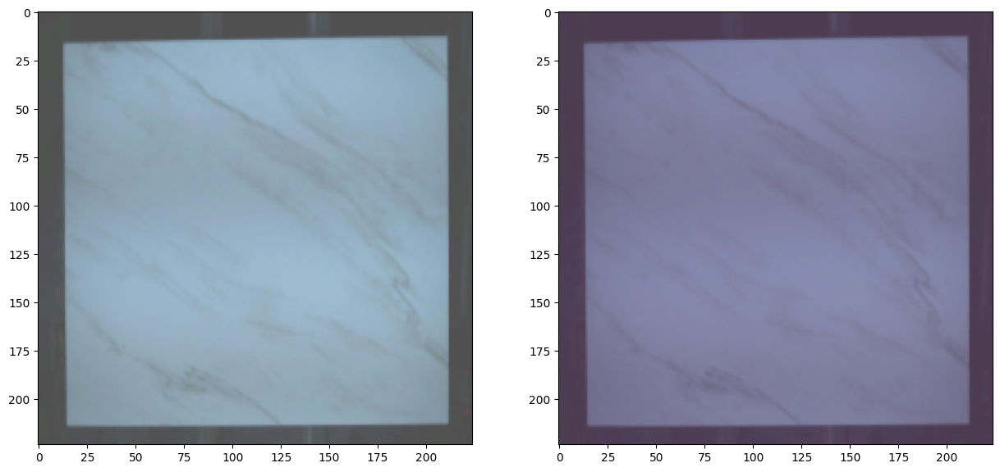

Threshold: 30895.55078125 MaxValue: 23443.501953125
Directory: good, Anomaly detected: False


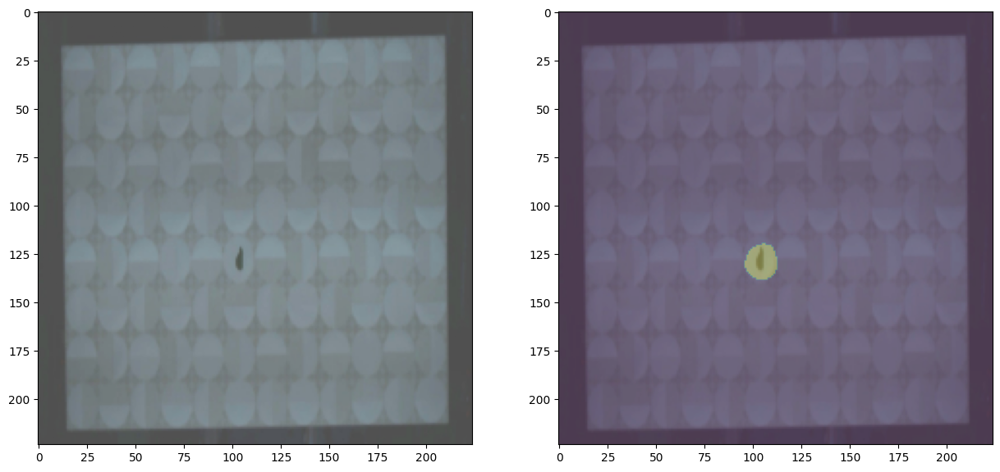

Threshold: 30895.55078125 MaxValue: 66837.828125
Directory: anomaly, Anomaly detected: True


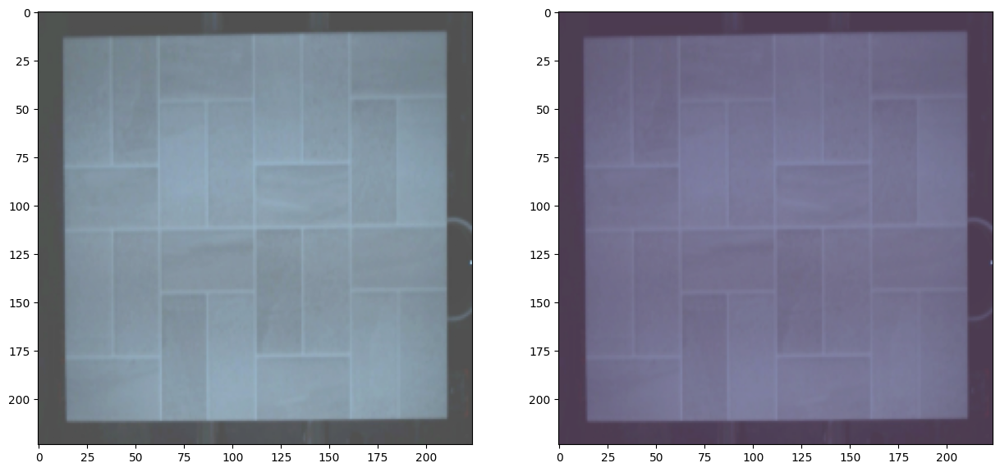

Threshold: 30895.55078125 MaxValue: 25422.8203125
Directory: good, Anomaly detected: False


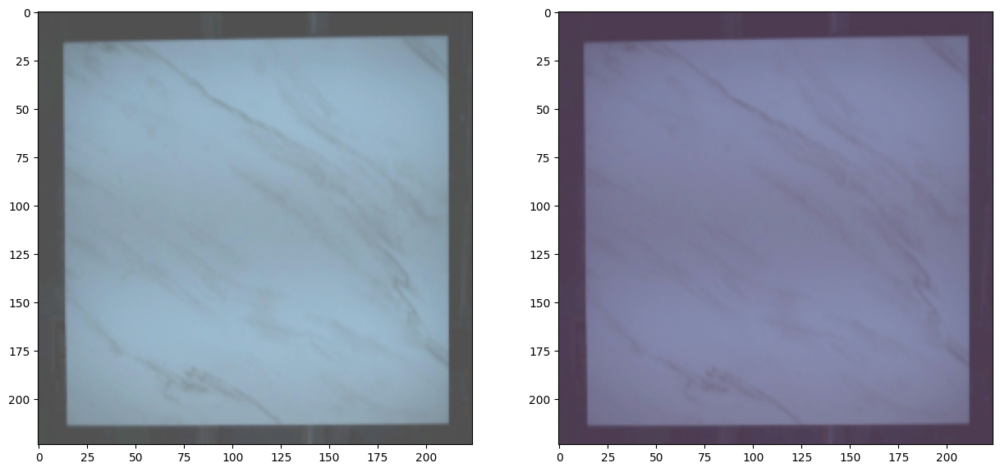

Threshold: 30895.55078125 MaxValue: 20421.39453125
Directory: good, Anomaly detected: False


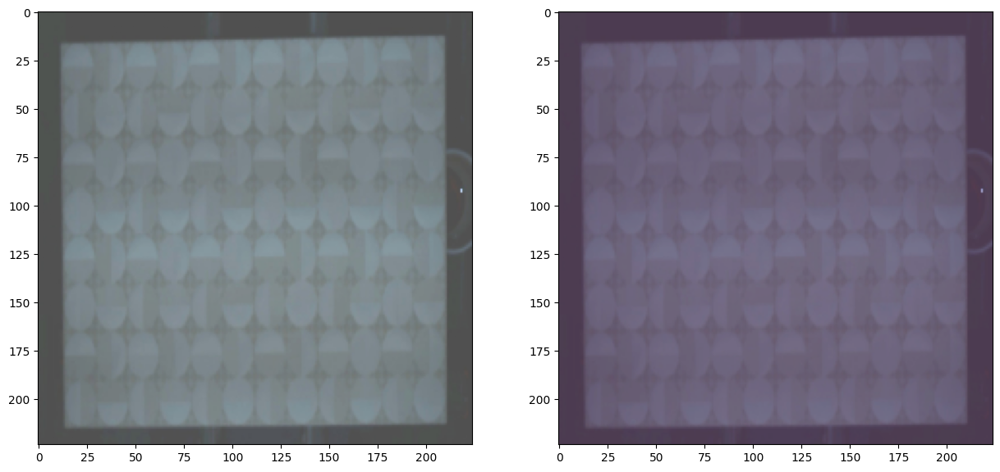

Threshold: 30895.55078125 MaxValue: 16849.626953125
Directory: good, Anomaly detected: False


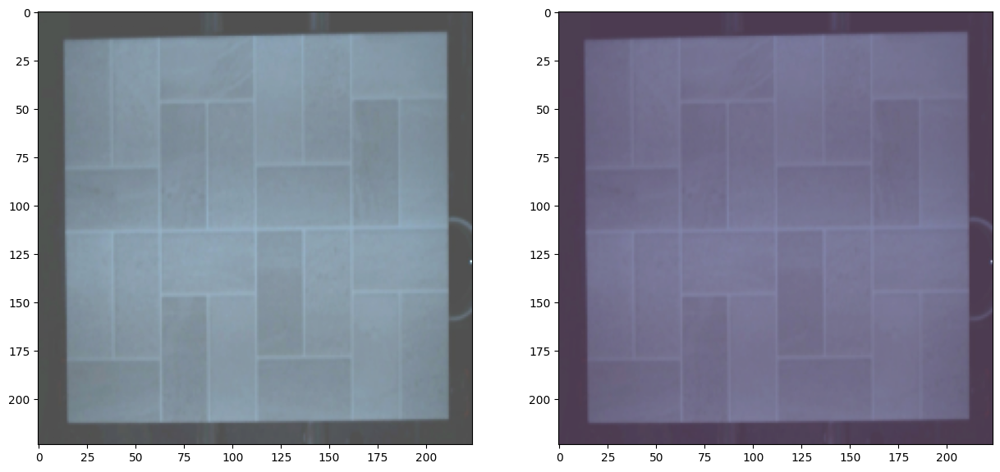

Threshold: 30895.55078125 MaxValue: 25845.89453125
Directory: good, Anomaly detected: False


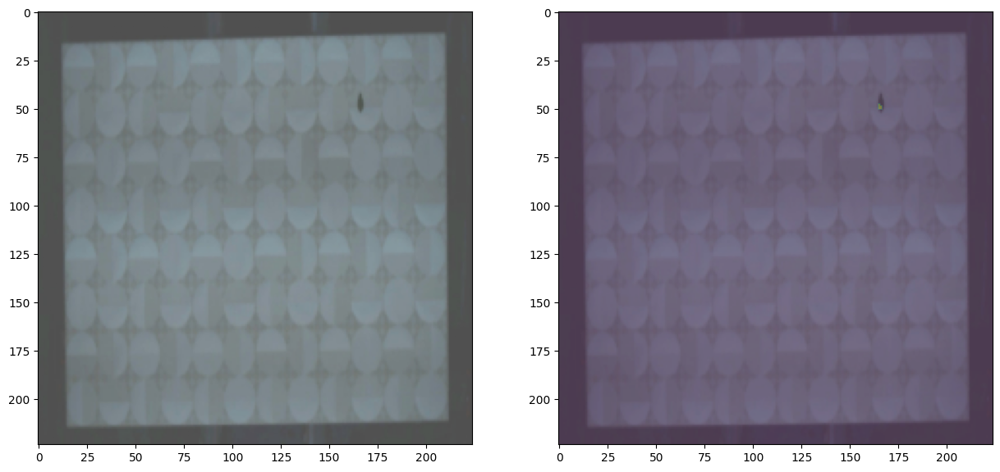

Threshold: 30895.55078125 MaxValue: 31946.37890625
Directory: anomaly, Anomaly detected: True


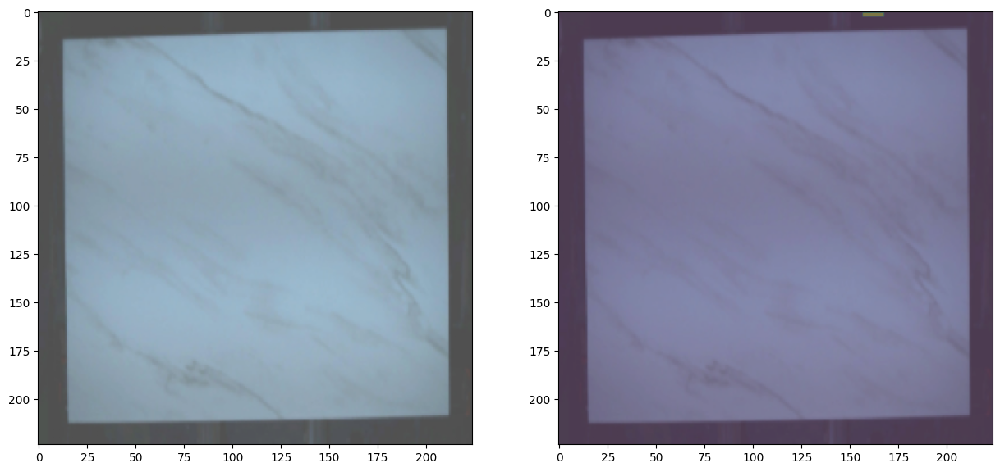

Threshold: 30895.55078125 MaxValue: 31275.0546875
Directory: good, Anomaly detected: True


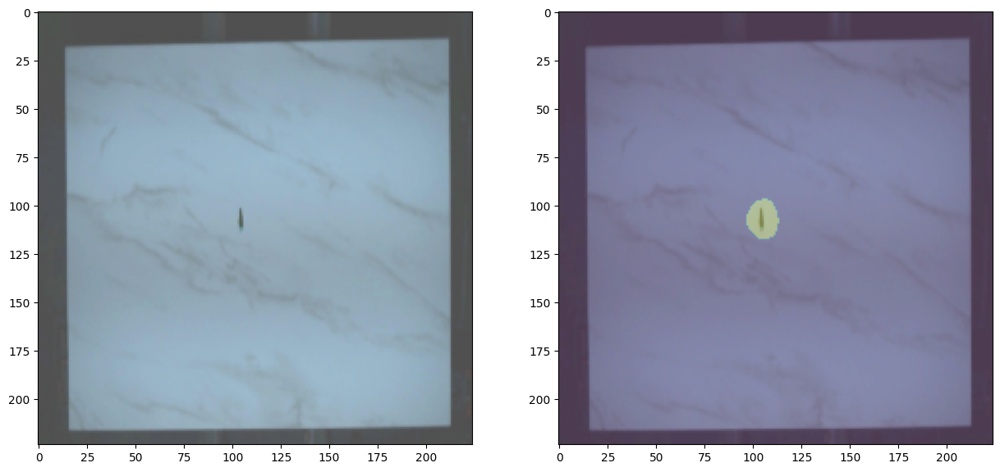

Threshold: 30895.55078125 MaxValue: 70123.3125
Directory: anomaly, Anomaly detected: True


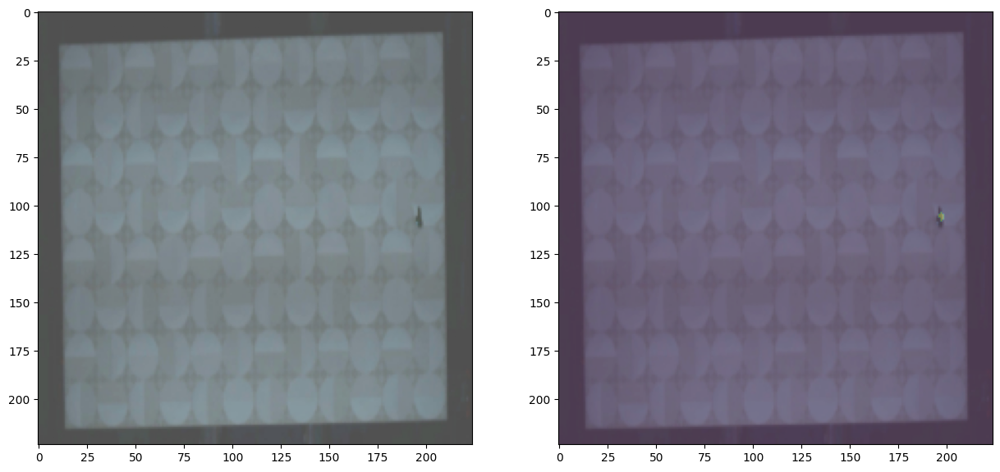

Threshold: 30895.55078125 MaxValue: 33045.83203125
Directory: anomaly, Anomaly detected: True


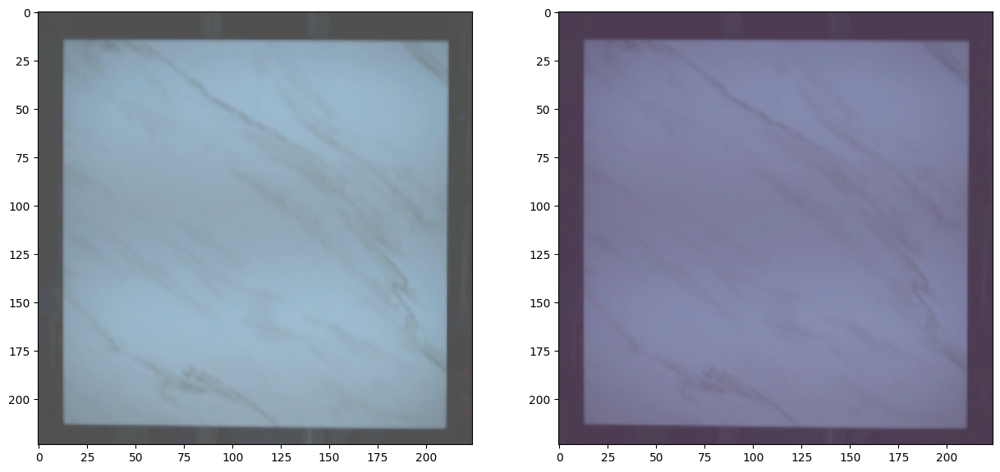

Threshold: 30895.55078125 MaxValue: 22592.259765625
Directory: good, Anomaly detected: False


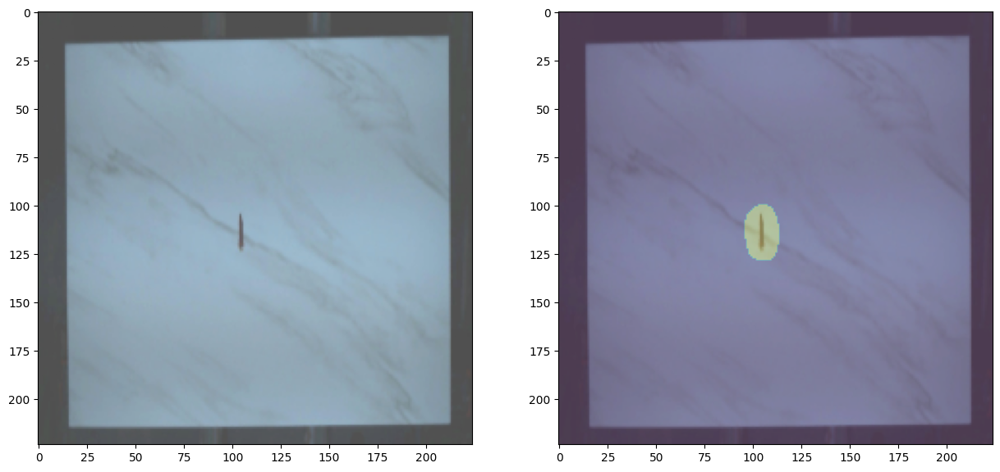

Threshold: 30895.55078125 MaxValue: 66254.328125
Directory: anomaly, Anomaly detected: True


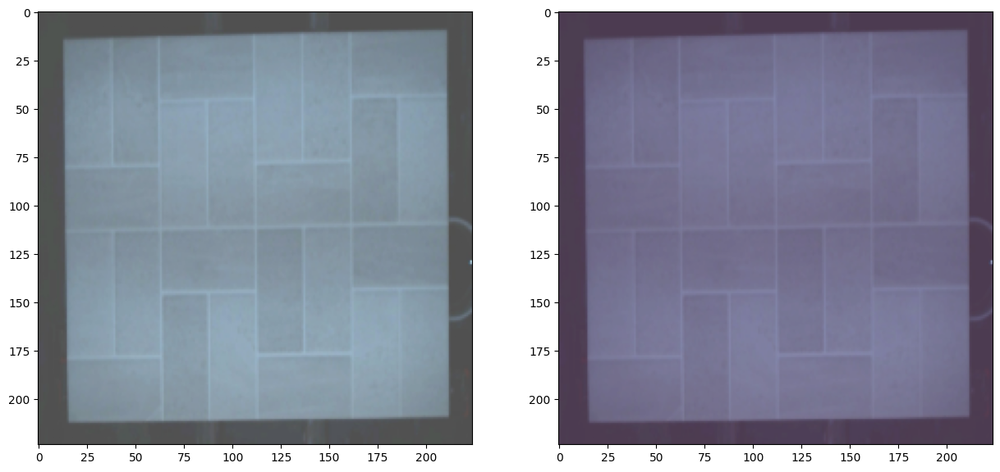

Threshold: 30895.55078125 MaxValue: 19911.439453125
Directory: good, Anomaly detected: False


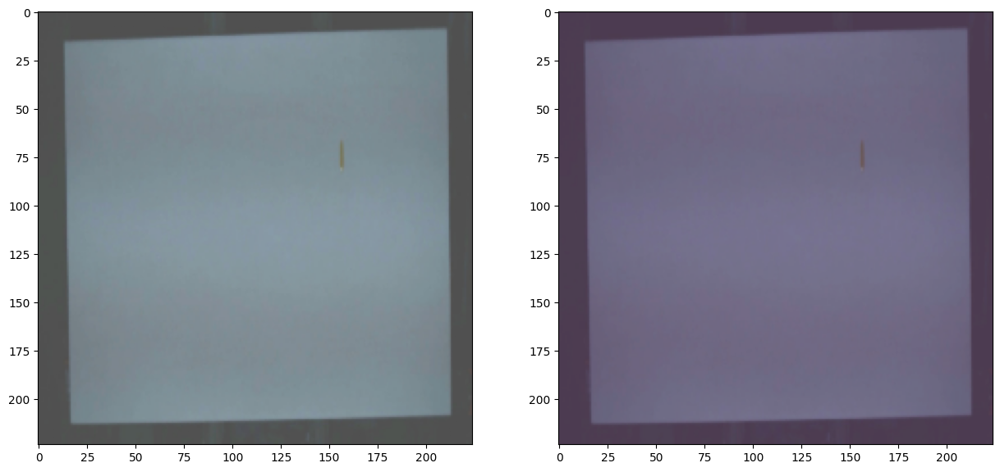

Threshold: 30895.55078125 MaxValue: 19358.01171875
Directory: anomaly, Anomaly detected: False


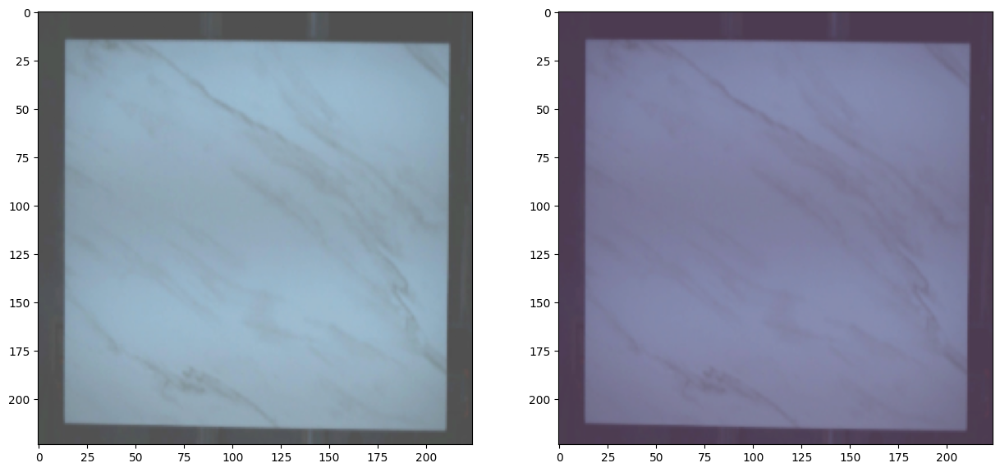

Threshold: 30895.55078125 MaxValue: 24198.4296875
Directory: good, Anomaly detected: False


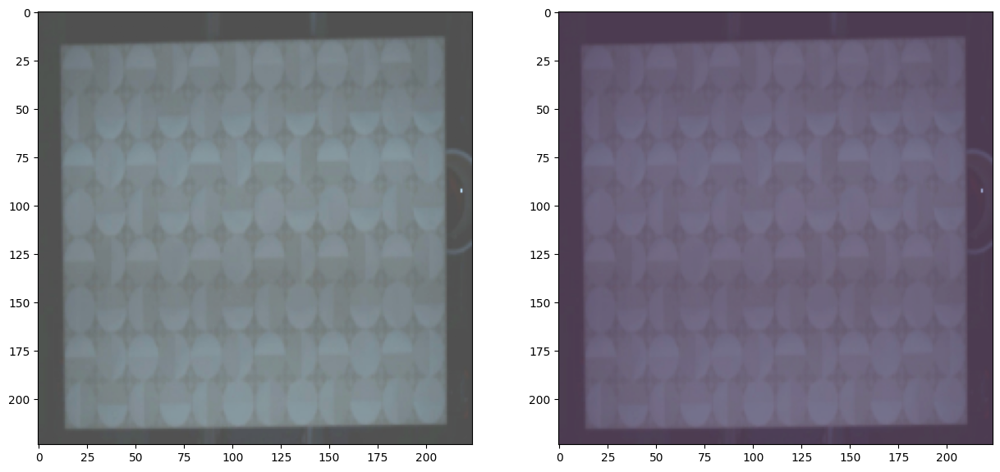

Threshold: 30895.55078125 MaxValue: 17894.765625
Directory: good, Anomaly detected: False


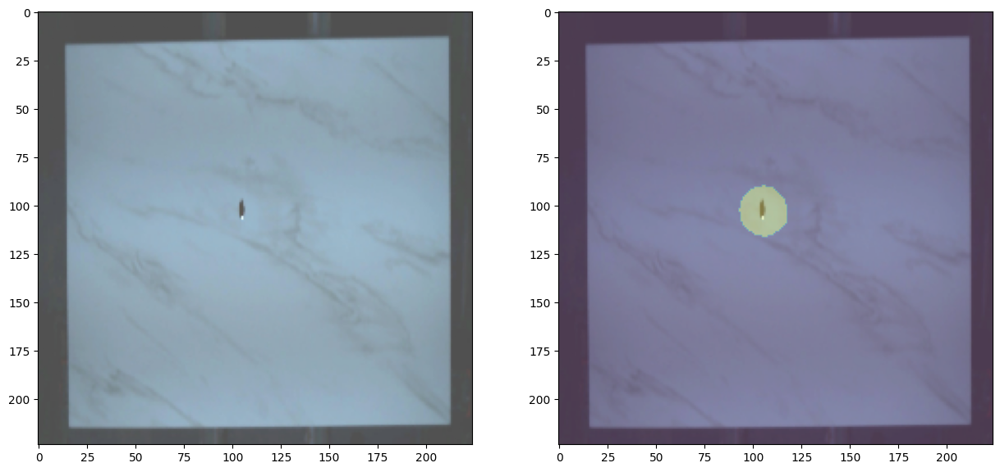

Threshold: 30895.55078125 MaxValue: 131820.71875
Directory: anomaly, Anomaly detected: True


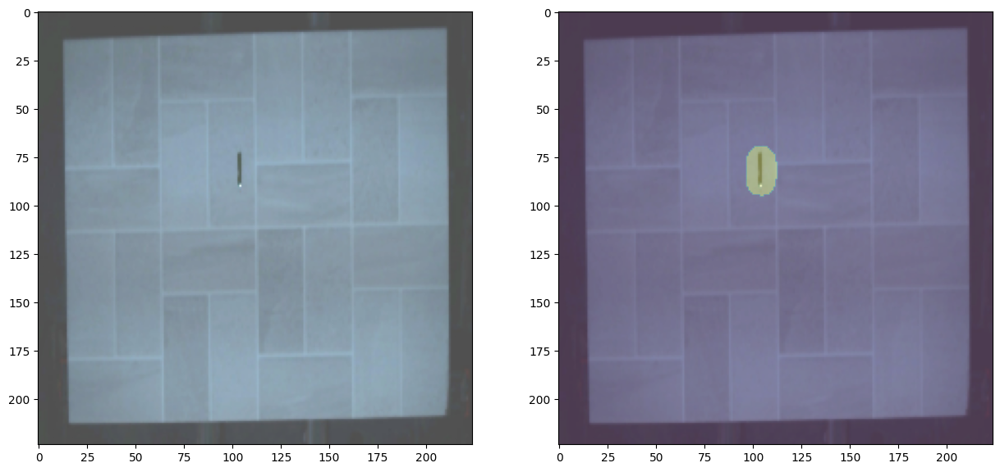

Threshold: 30895.55078125 MaxValue: 57141.953125
Directory: anomaly, Anomaly detected: True


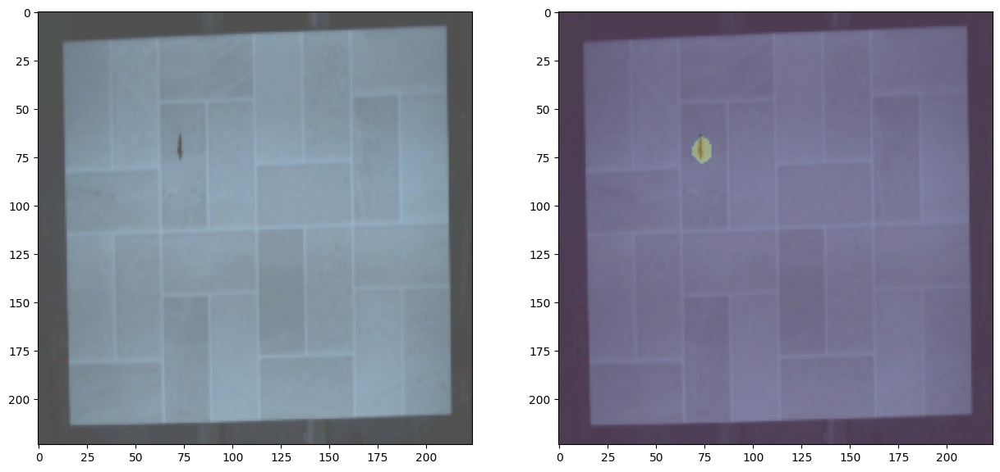

Threshold: 30895.55078125 MaxValue: 44809.01953125
Directory: anomaly, Anomaly detected: True


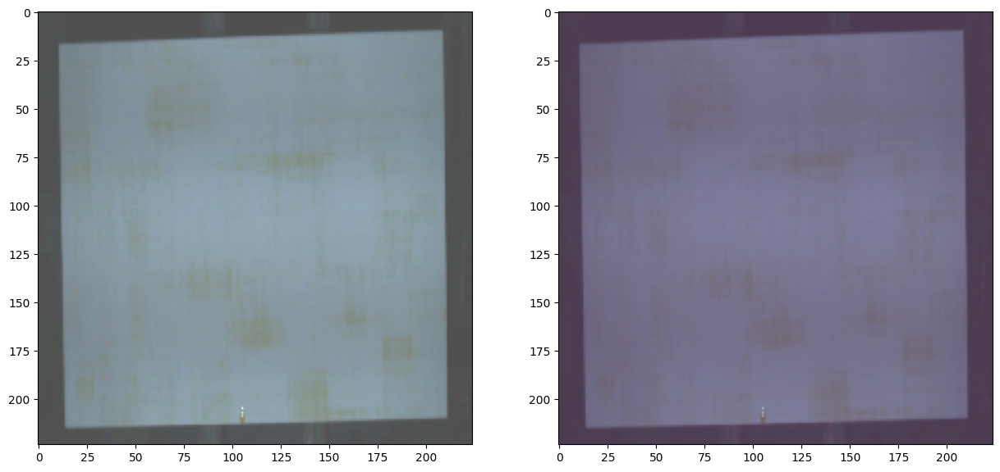

Threshold: 30895.55078125 MaxValue: 21421.513671875
Directory: anomaly, Anomaly detected: False


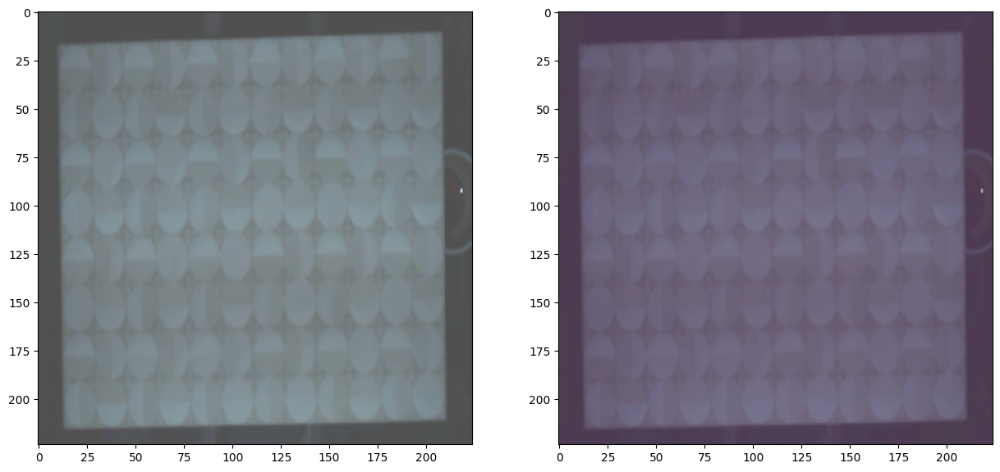

Threshold: 30895.55078125 MaxValue: 19911.76171875
Directory: good, Anomaly detected: False


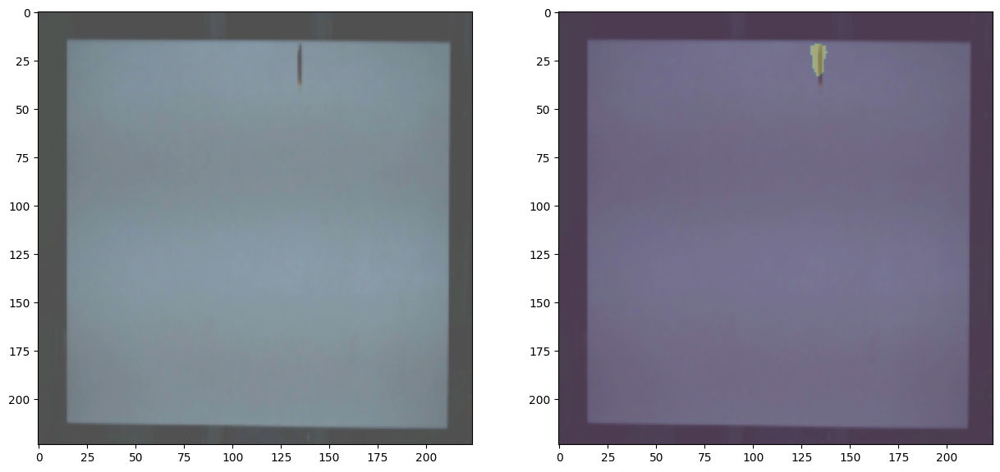

Threshold: 30895.55078125 MaxValue: 37032.875
Directory: anomaly, Anomaly detected: True


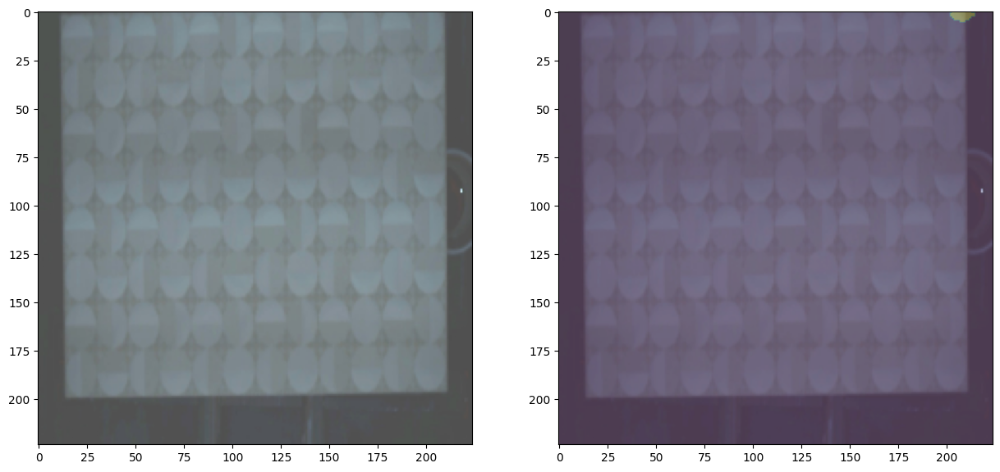

Threshold: 30895.55078125 MaxValue: 37951.83203125
Directory: good, Anomaly detected: True


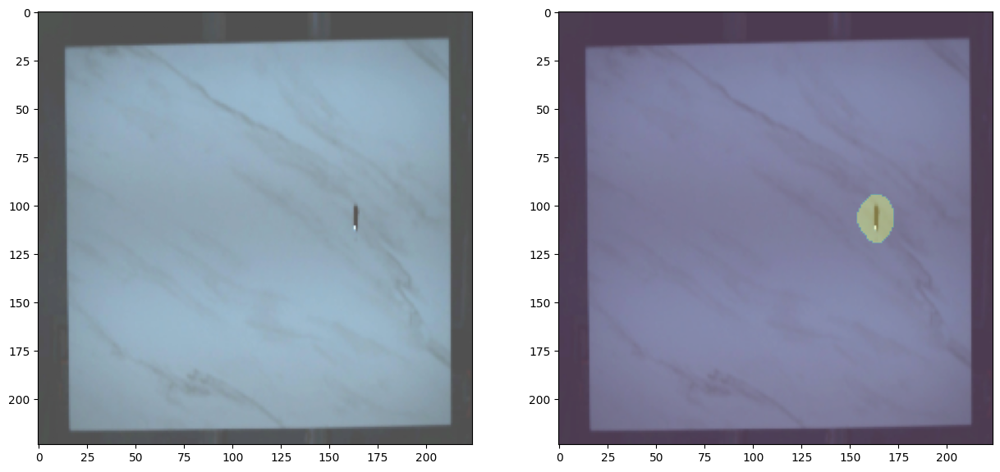

Threshold: 30895.55078125 MaxValue: 80236.8828125
Directory: anomaly, Anomaly detected: True


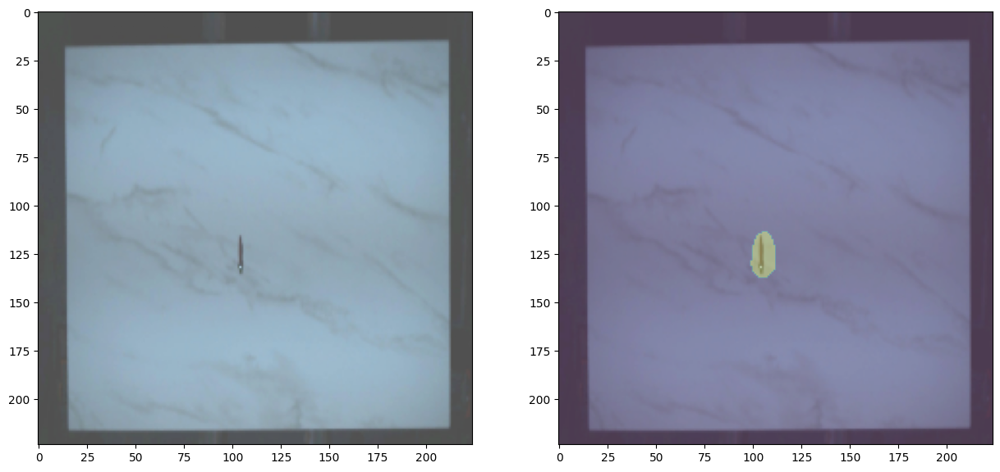

Threshold: 30895.55078125 MaxValue: 49835.80078125
Directory: anomaly, Anomaly detected: True


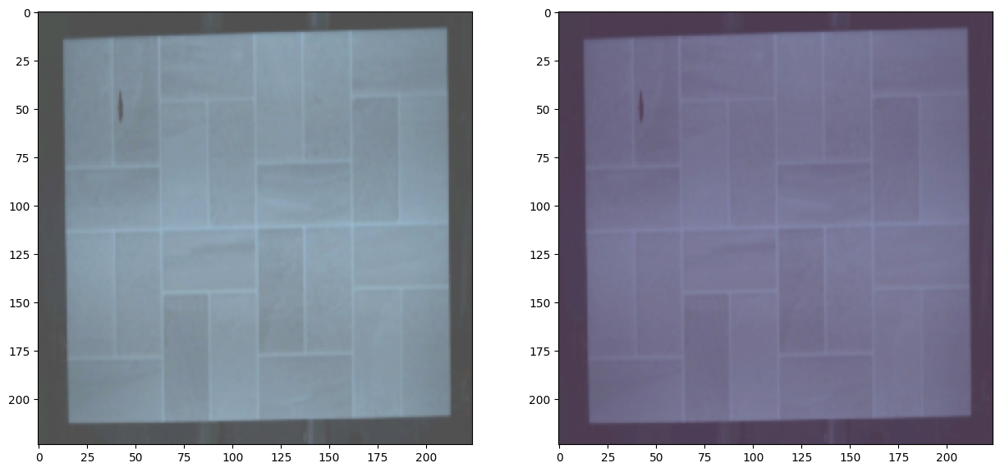

Threshold: 30895.55078125 MaxValue: 28506.203125
Directory: anomaly, Anomaly detected: False


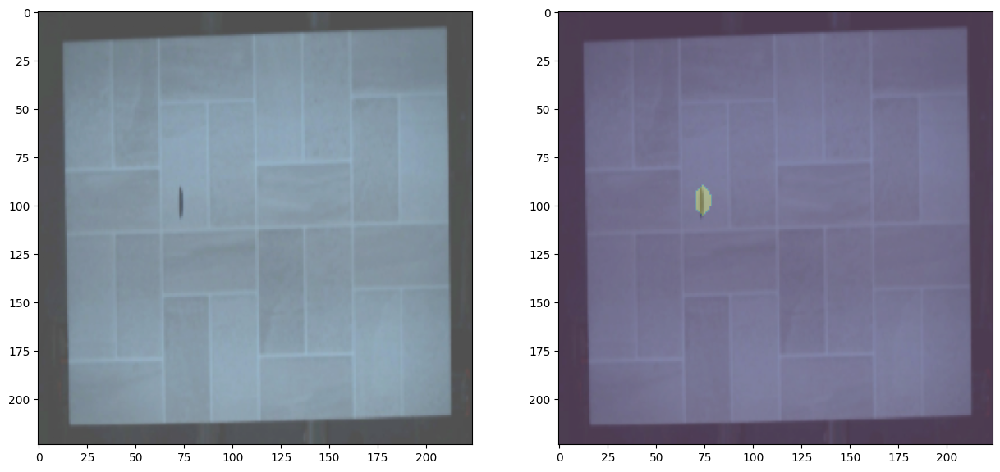

Threshold: 30895.55078125 MaxValue: 41430.2265625
Directory: anomaly, Anomaly detected: True


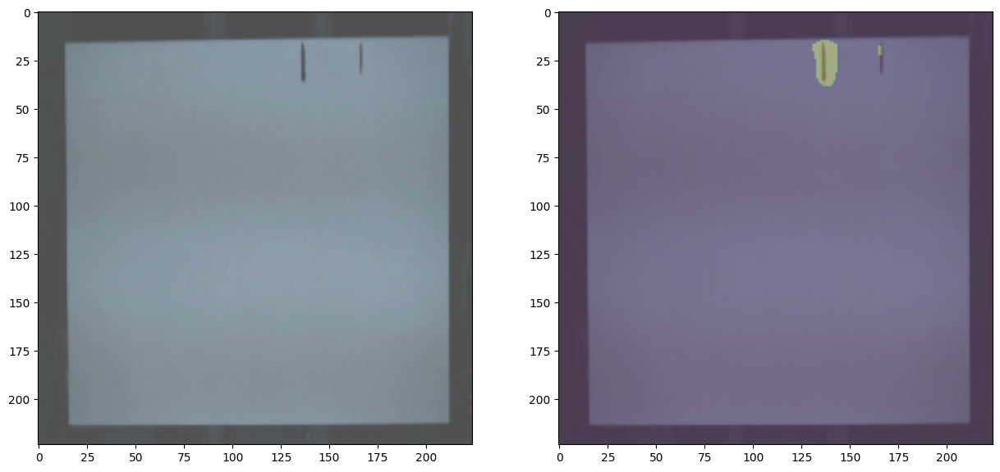

Threshold: 30895.55078125 MaxValue: 45426.8359375
Directory: anomaly, Anomaly detected: True


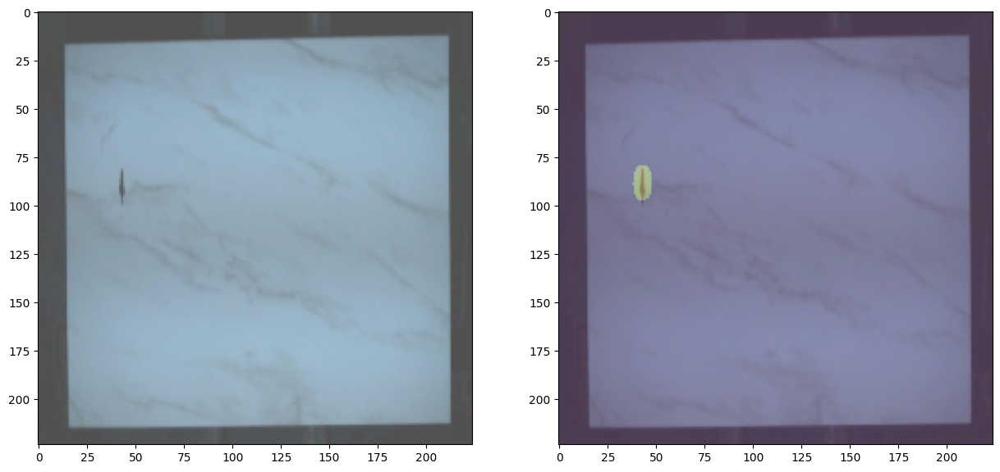

Threshold: 30895.55078125 MaxValue: 45173.31640625
Directory: anomaly, Anomaly detected: True


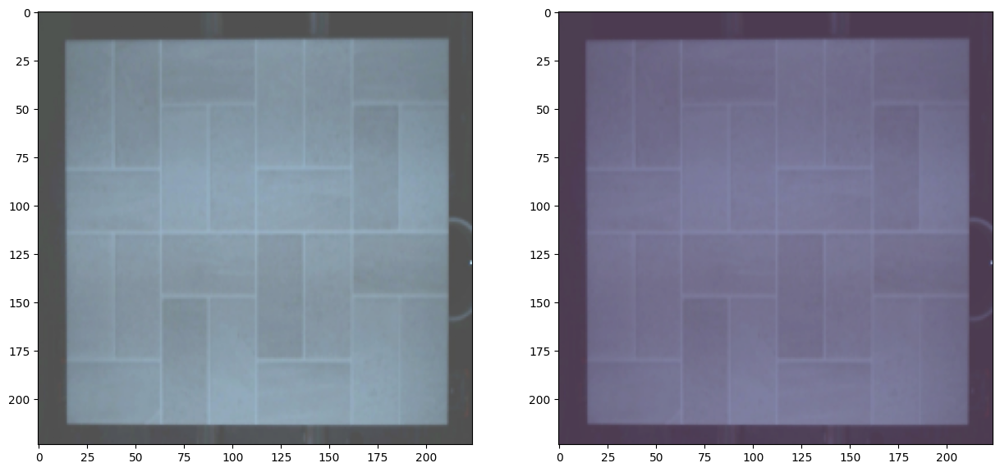

Threshold: 30895.55078125 MaxValue: 25197.869140625
Directory: good, Anomaly detected: False


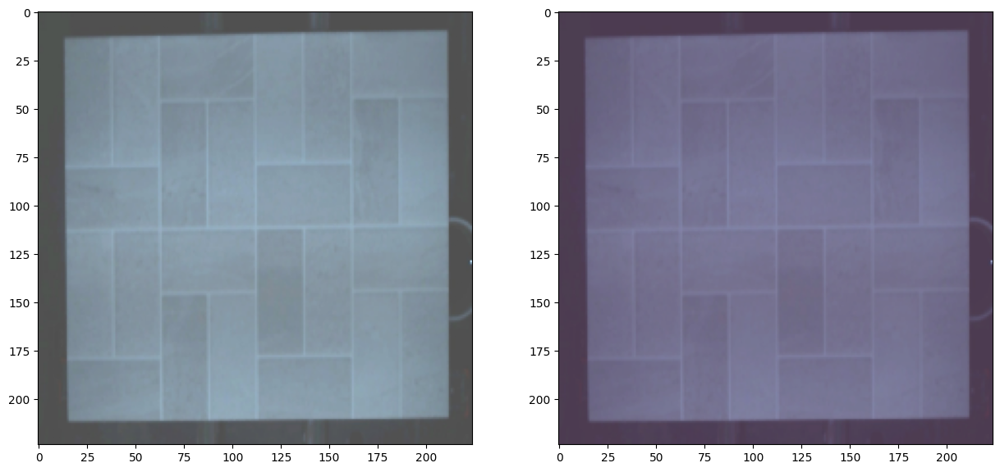

Threshold: 30895.55078125 MaxValue: 26421.822265625
Directory: good, Anomaly detected: False


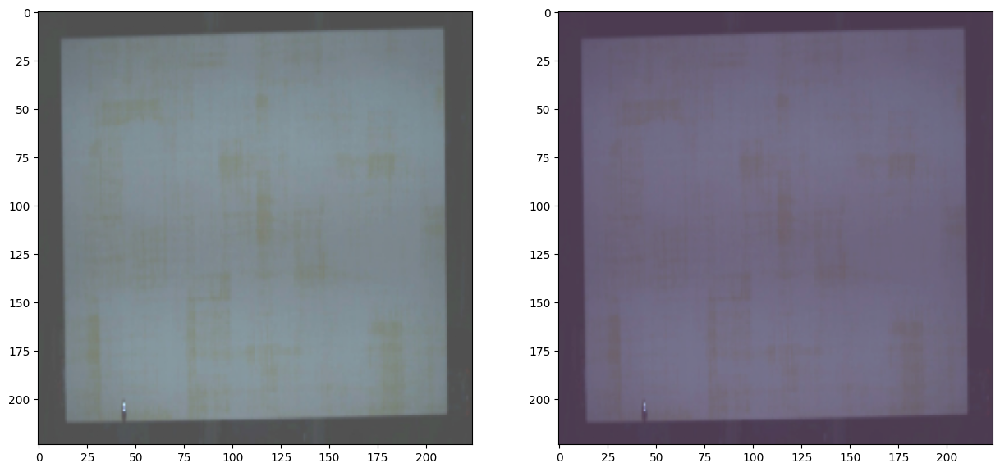

Threshold: 30895.55078125 MaxValue: 30230.267578125
Directory: anomaly, Anomaly detected: True


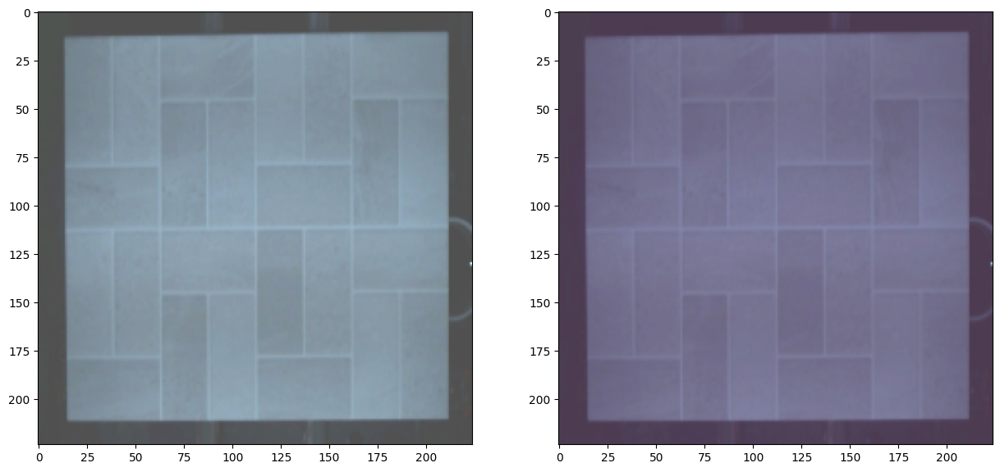

Threshold: 30895.55078125 MaxValue: 26563.029296875
Directory: good, Anomaly detected: False


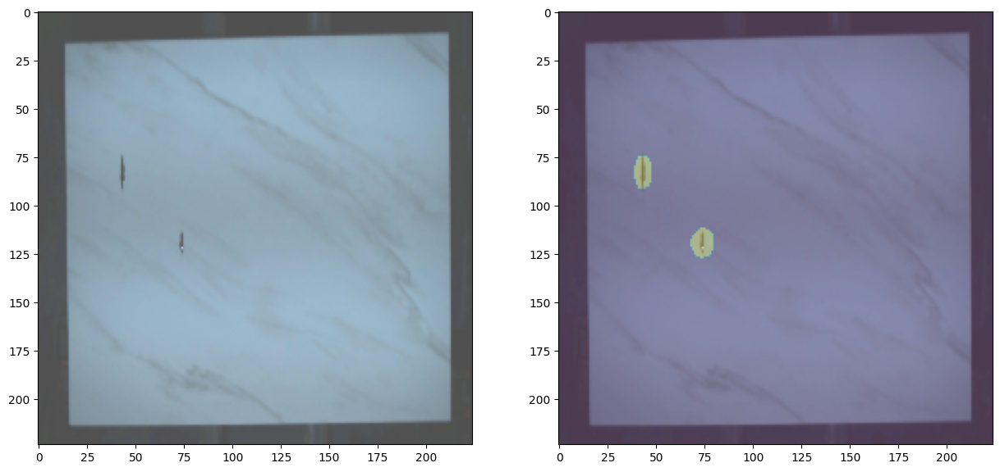

Threshold: 30895.55078125 MaxValue: 51953.29296875
Directory: anomaly, Anomaly detected: True


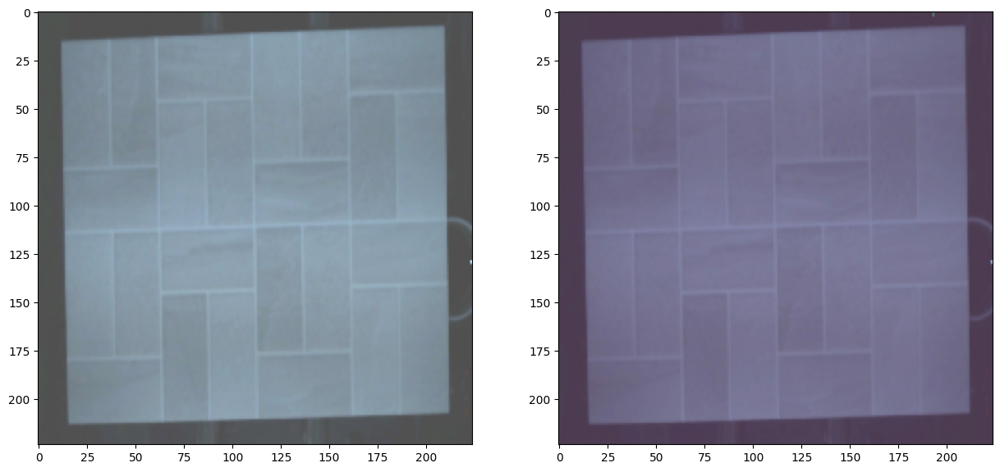

Threshold: 30895.55078125 MaxValue: 30942.458984375
Directory: good, Anomaly detected: True


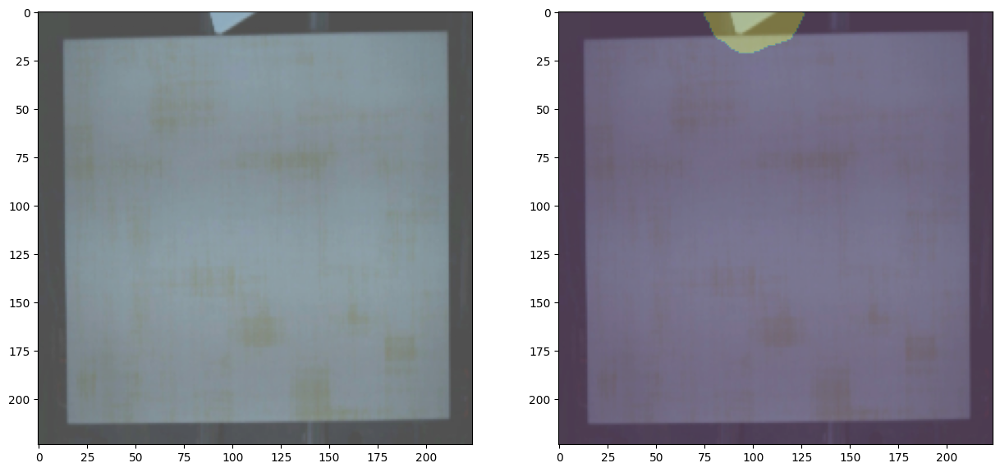

Threshold: 30895.55078125 MaxValue: 110035.671875
Directory: good, Anomaly detected: True


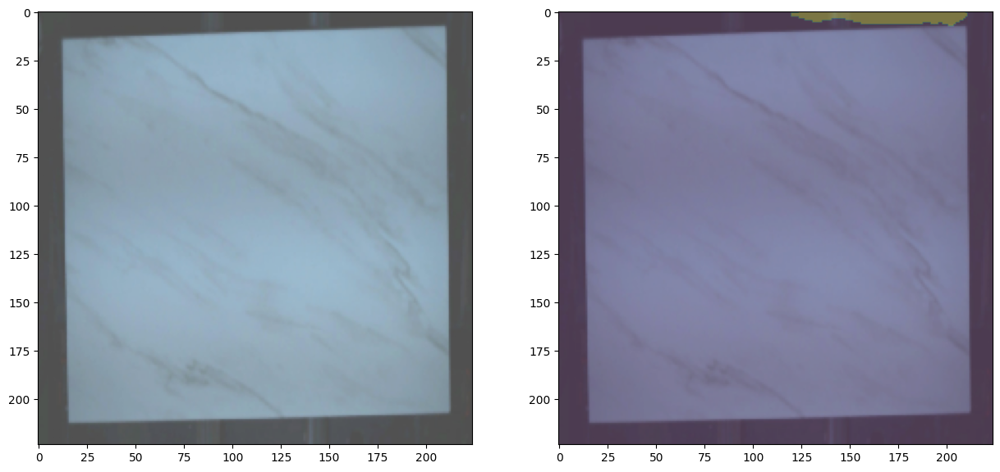

Threshold: 30895.55078125 MaxValue: 41233.3125
Directory: good, Anomaly detected: True


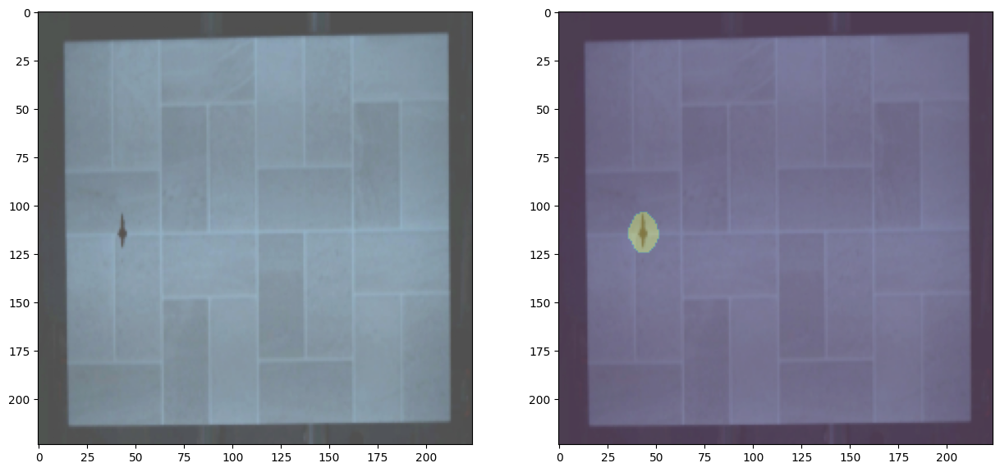

Threshold: 30895.55078125 MaxValue: 65999.1484375
Directory: anomaly, Anomaly detected: True


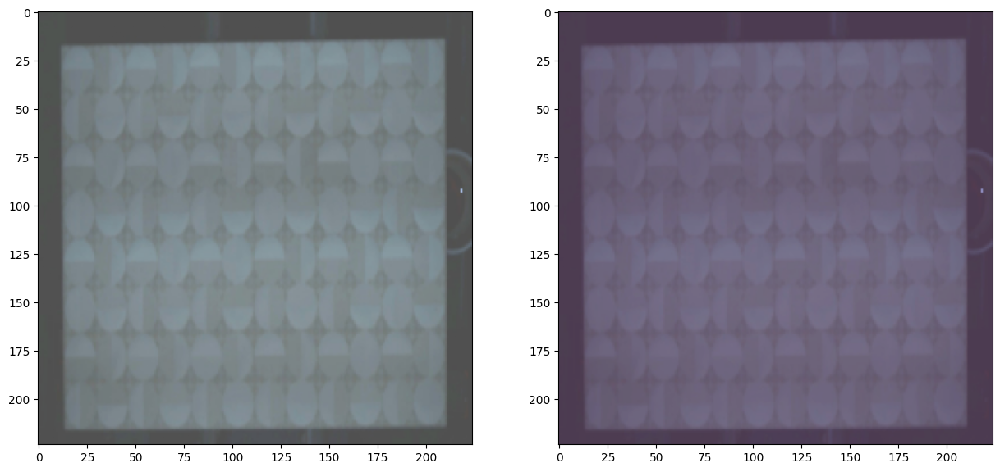

Threshold: 30895.55078125 MaxValue: 14495.3662109375
Directory: good, Anomaly detected: False


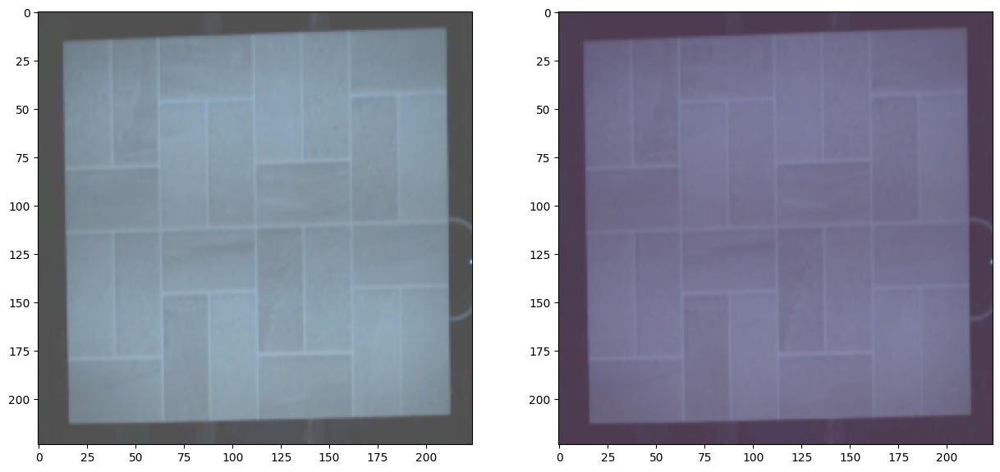

Threshold: 30895.55078125 MaxValue: 20768.560546875
Directory: good, Anomaly detected: False


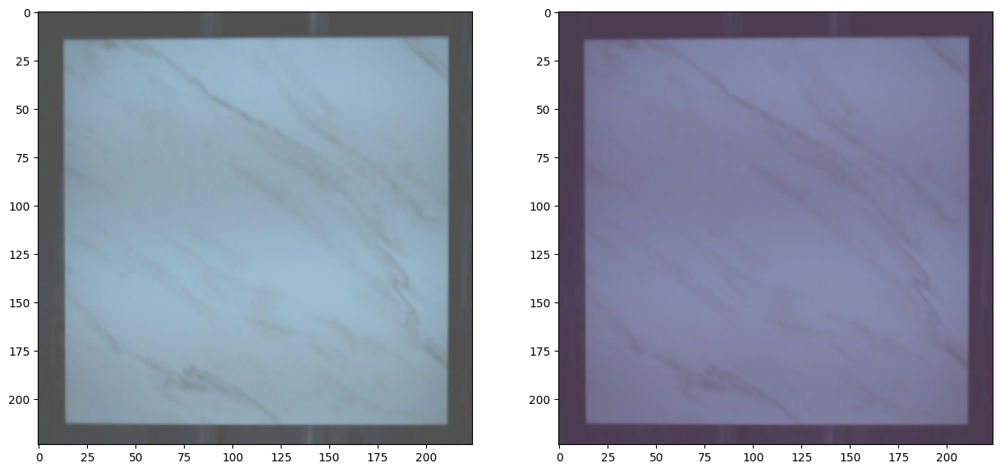

Threshold: 30895.55078125 MaxValue: 22786.5
Directory: good, Anomaly detected: False


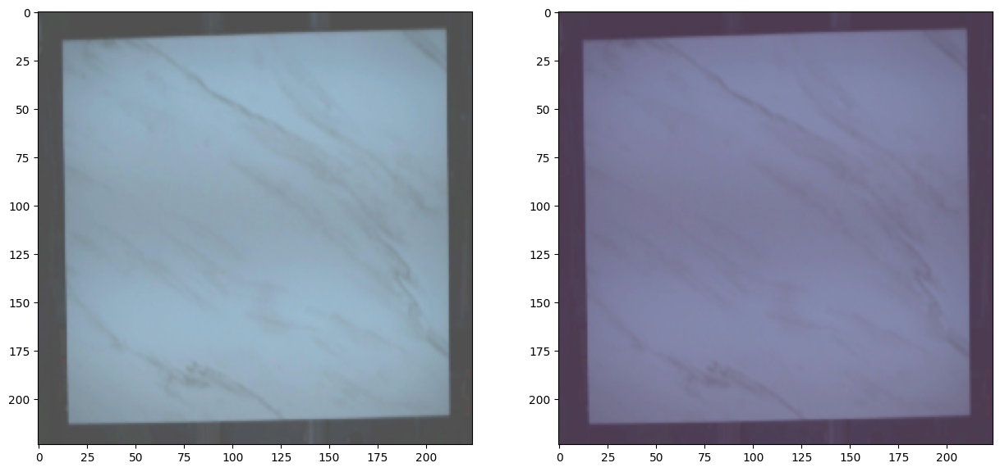

Threshold: 30895.55078125 MaxValue: 26198.025390625
Directory: good, Anomaly detected: False


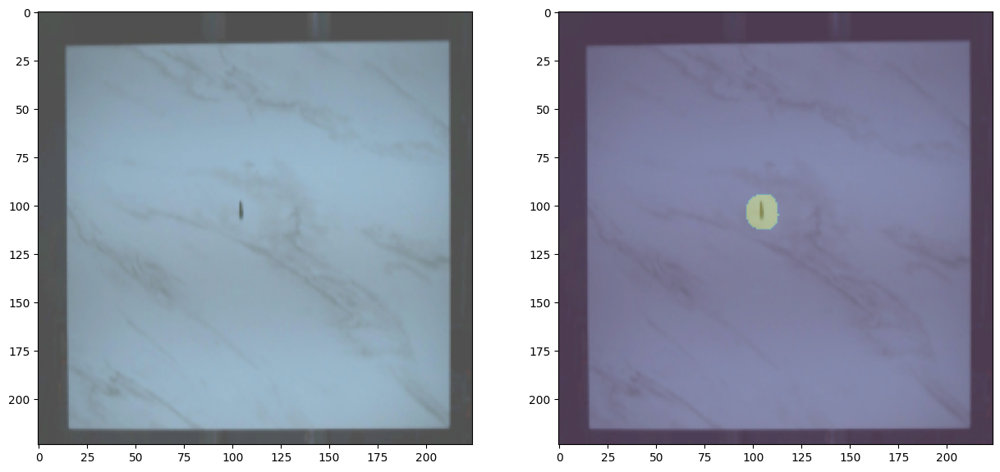

Threshold: 30895.55078125 MaxValue: 71845.8046875
Directory: anomaly, Anomaly detected: True


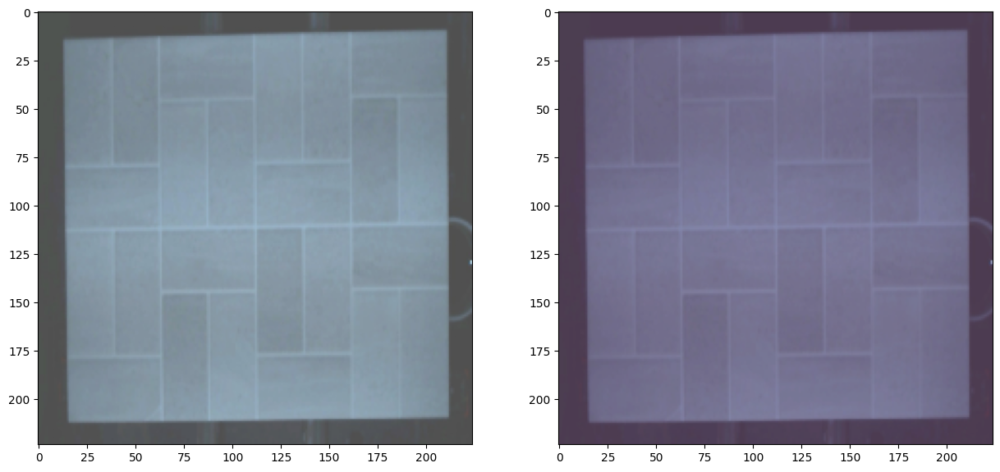

Threshold: 30895.55078125 MaxValue: 26450.927734375
Directory: good, Anomaly detected: False


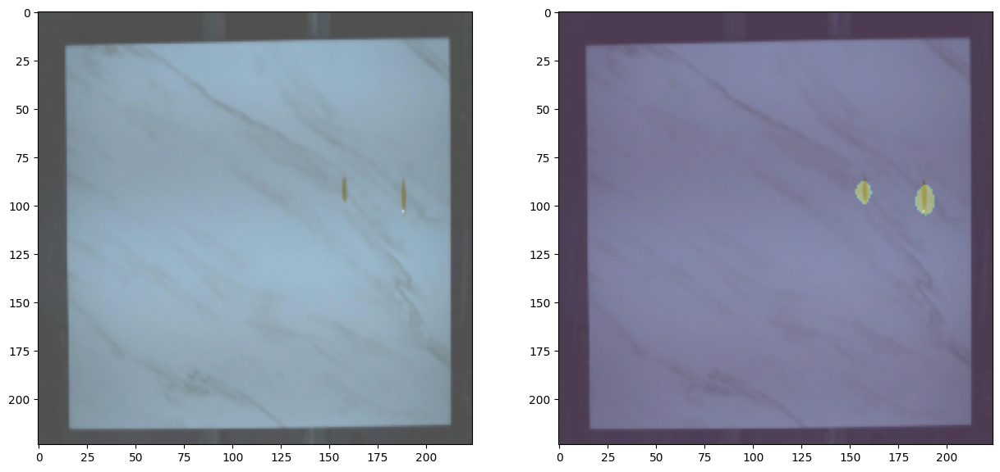

Threshold: 30895.55078125 MaxValue: 45342.02734375
Directory: anomaly, Anomaly detected: True


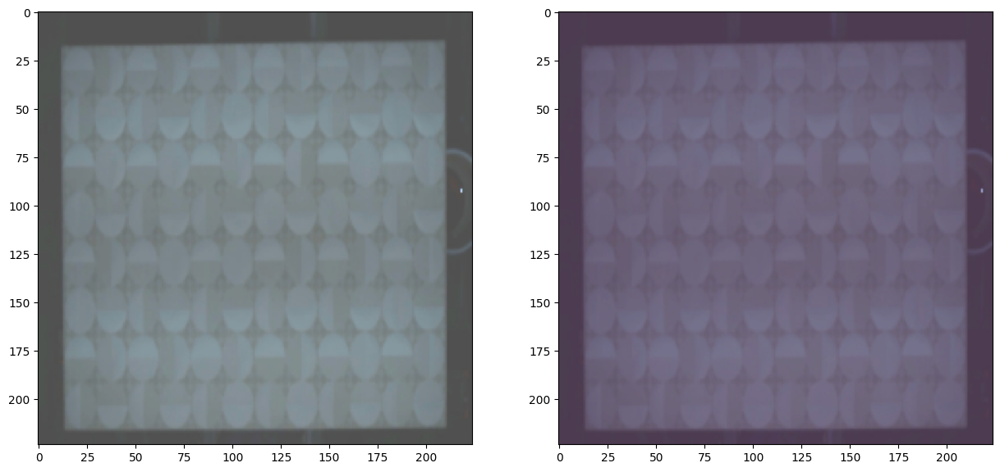

Threshold: 30895.55078125 MaxValue: 16628.4921875
Directory: good, Anomaly detected: False


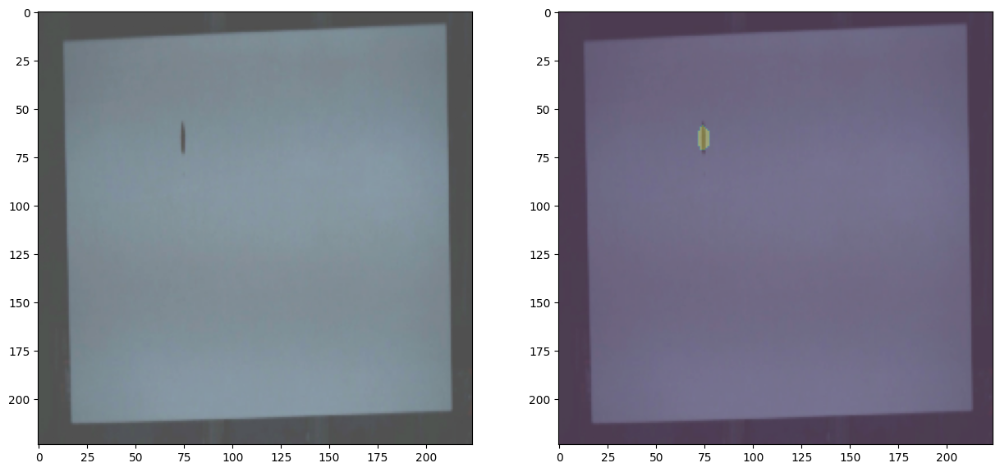

Threshold: 30895.55078125 MaxValue: 37072.50390625
Directory: anomaly, Anomaly detected: True


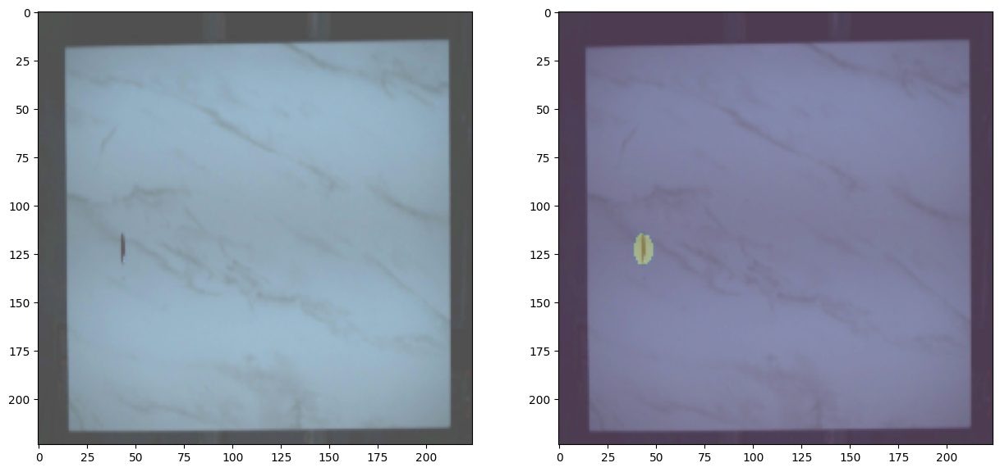

Threshold: 30895.55078125 MaxValue: 44544.80078125
Directory: anomaly, Anomaly detected: True


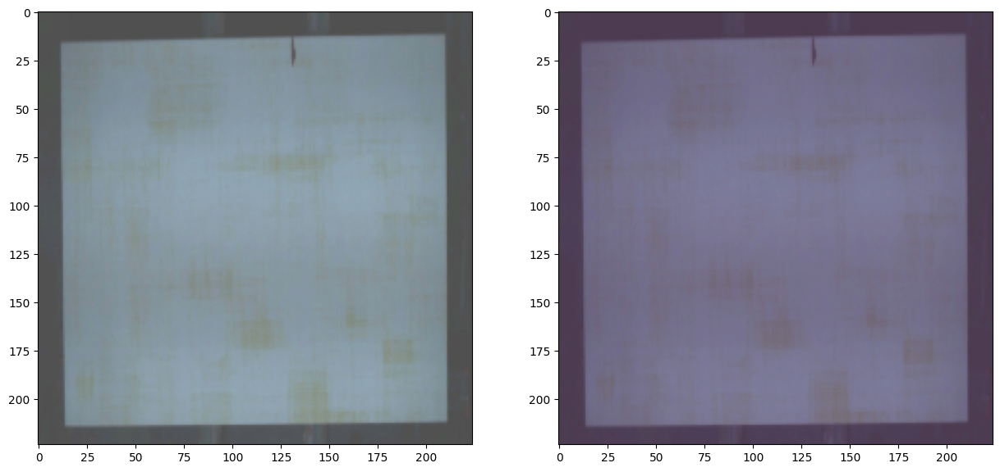

Threshold: 30895.55078125 MaxValue: 26754.72265625
Directory: anomaly, Anomaly detected: False


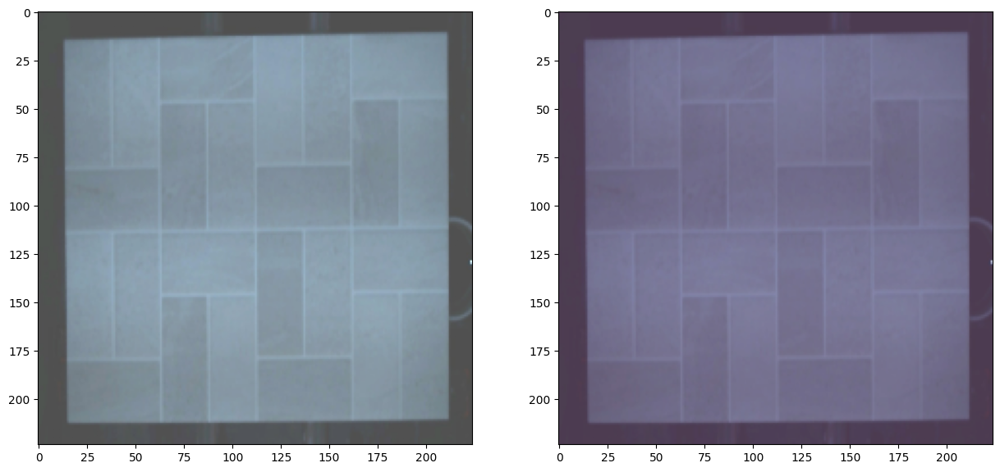

Threshold: 30895.55078125 MaxValue: 23299.857421875
Directory: good, Anomaly detected: False


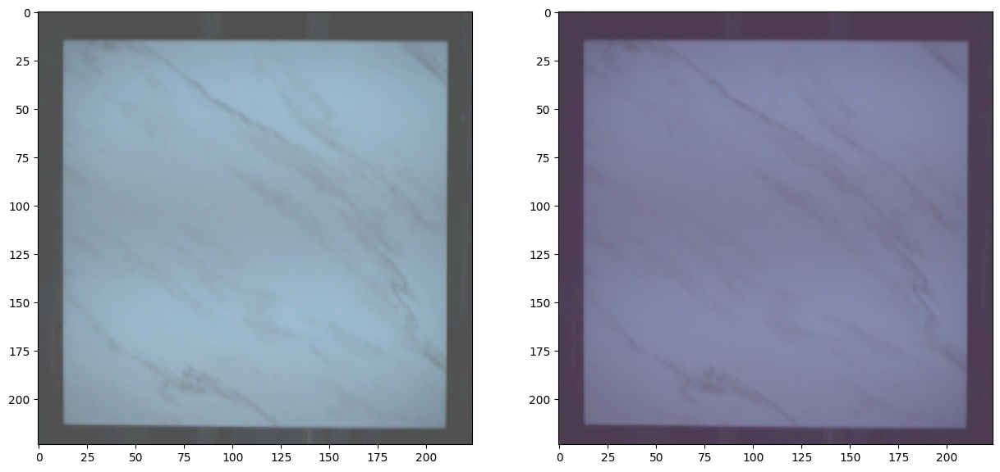

Threshold: 30895.55078125 MaxValue: 23371.447265625
Directory: good, Anomaly detected: False


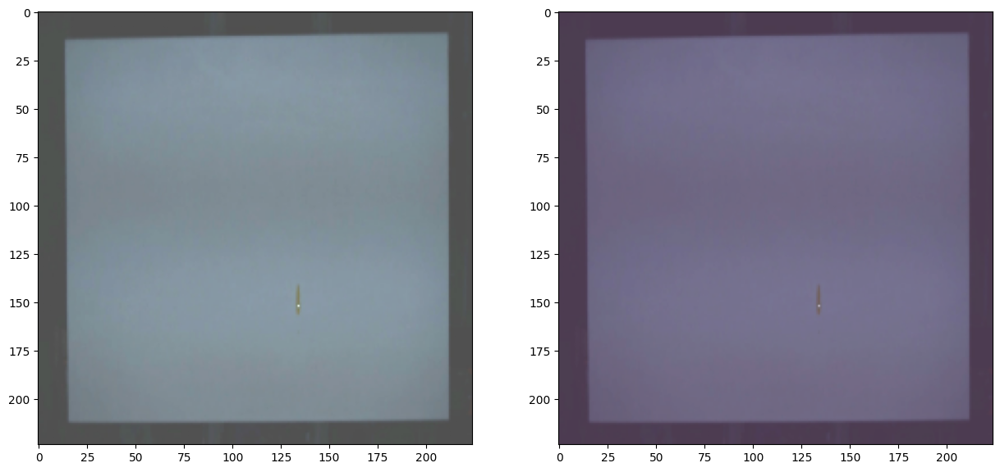

Threshold: 30895.55078125 MaxValue: 24639.61328125
Directory: anomaly, Anomaly detected: False


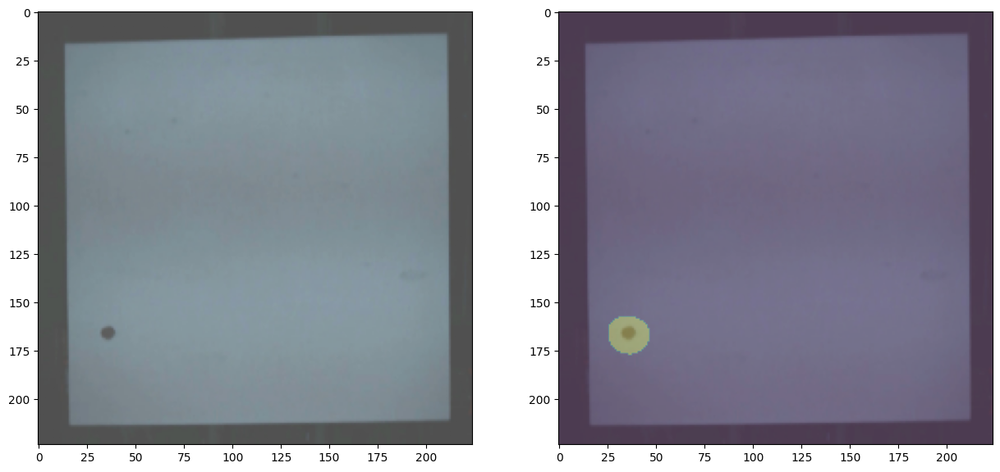

Threshold: 30895.55078125 MaxValue: 99936.6015625
Directory: anomaly, Anomaly detected: True


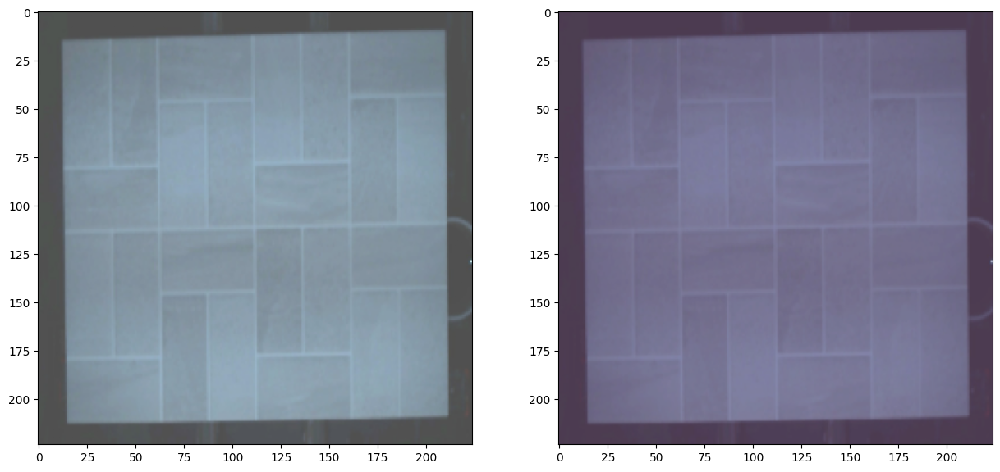

Threshold: 30895.55078125 MaxValue: 23519.9375
Directory: good, Anomaly detected: False


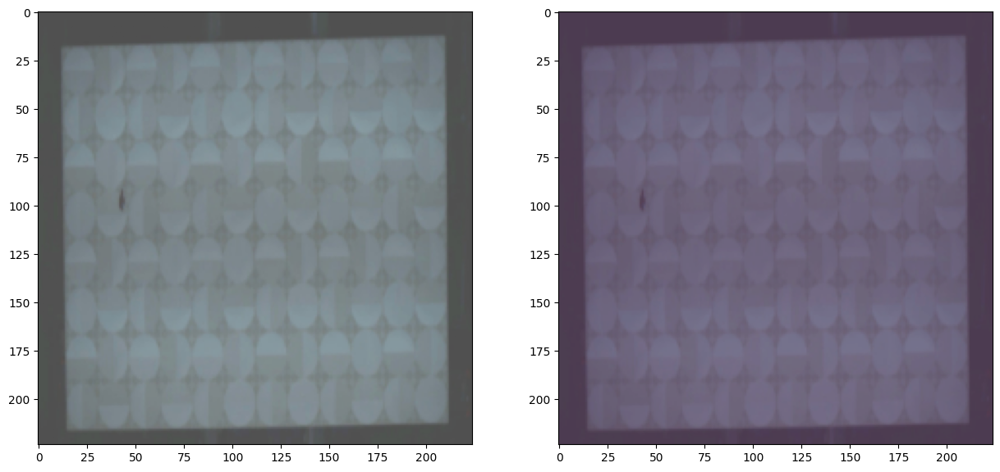

Threshold: 30895.55078125 MaxValue: 16670.8984375
Directory: anomaly, Anomaly detected: False


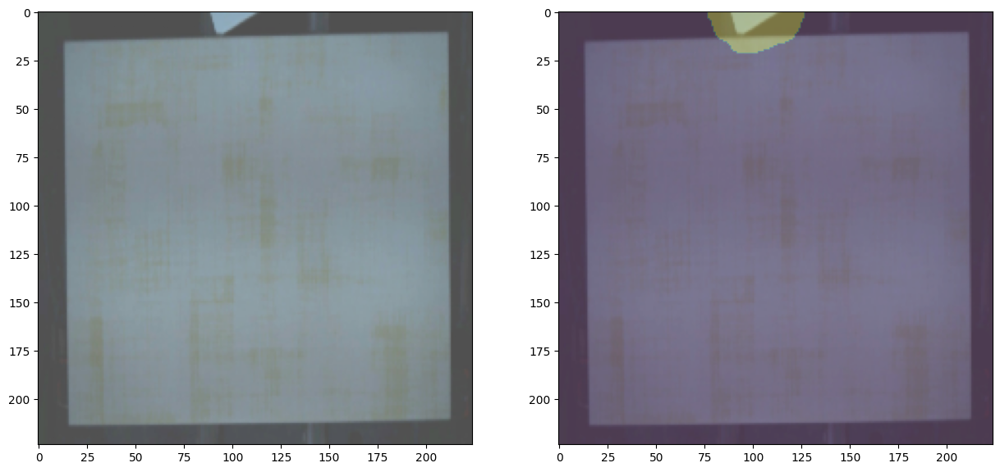

Threshold: 30895.55078125 MaxValue: 113315.390625
Directory: good, Anomaly detected: True


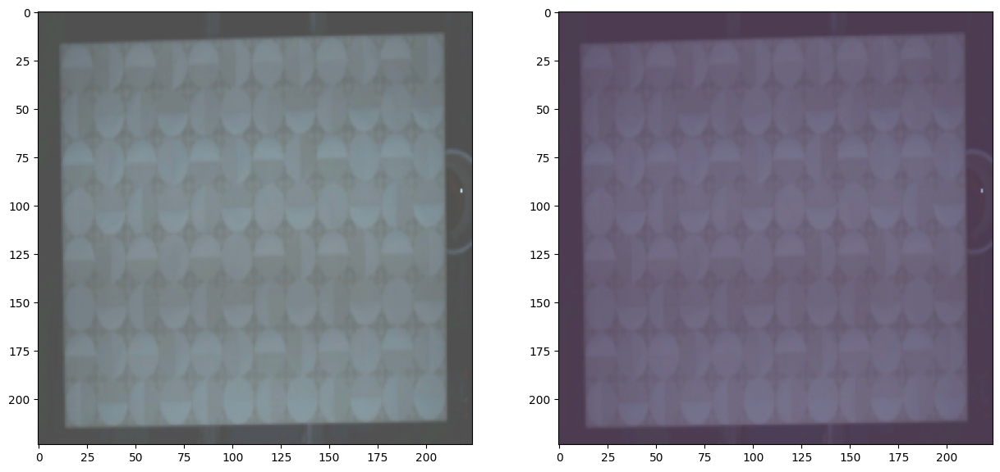

Threshold: 30895.55078125 MaxValue: 18359.197265625
Directory: good, Anomaly detected: False


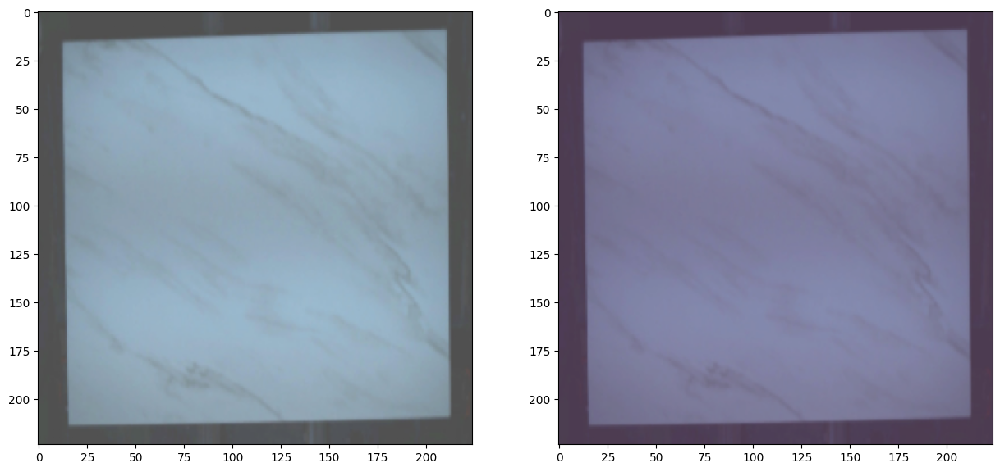

Threshold: 30895.55078125 MaxValue: 25893.490234375
Directory: good, Anomaly detected: False


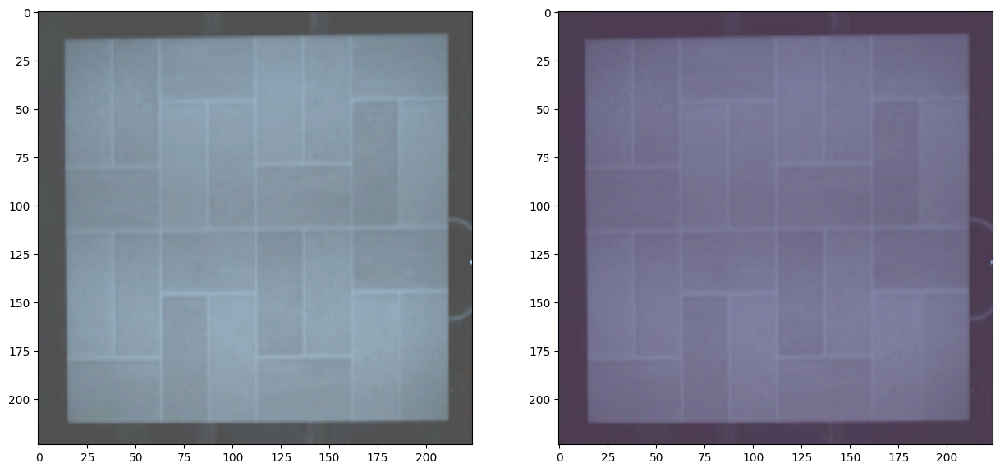

Threshold: 30895.55078125 MaxValue: 20091.21484375
Directory: good, Anomaly detected: False


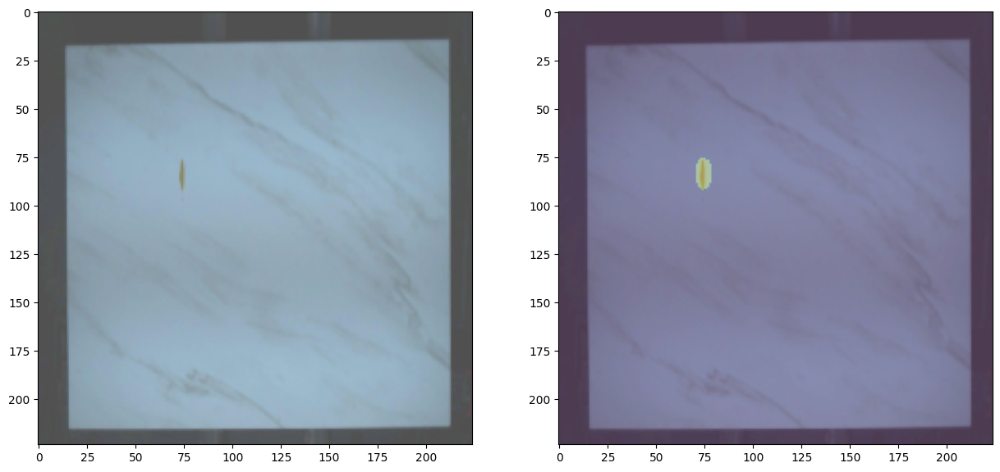

Threshold: 30895.55078125 MaxValue: 42563.43359375
Directory: anomaly, Anomaly detected: True


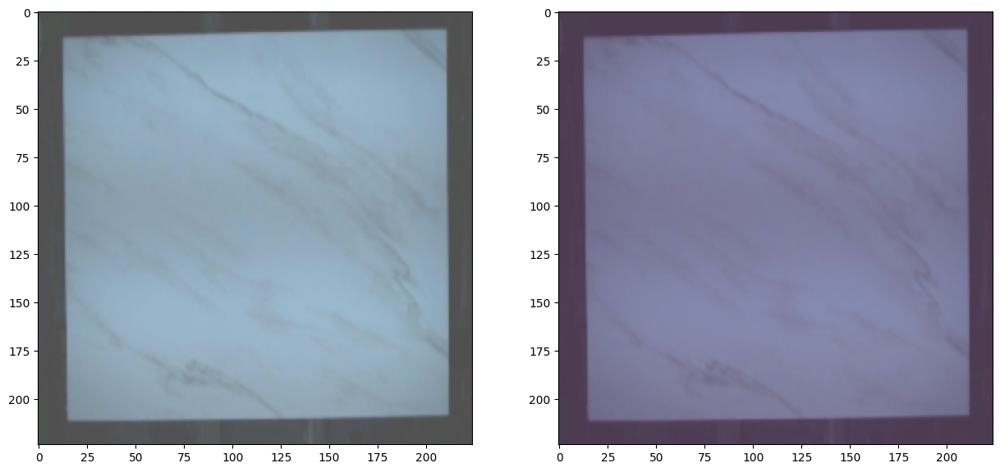

Threshold: 30895.55078125 MaxValue: 29410.091796875
Directory: good, Anomaly detected: False


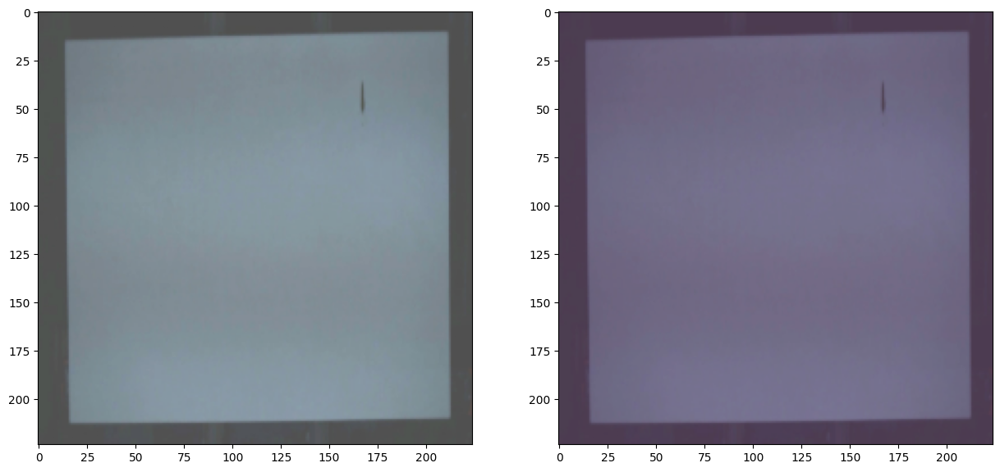

Threshold: 30895.55078125 MaxValue: 24511.052734375
Directory: anomaly, Anomaly detected: False


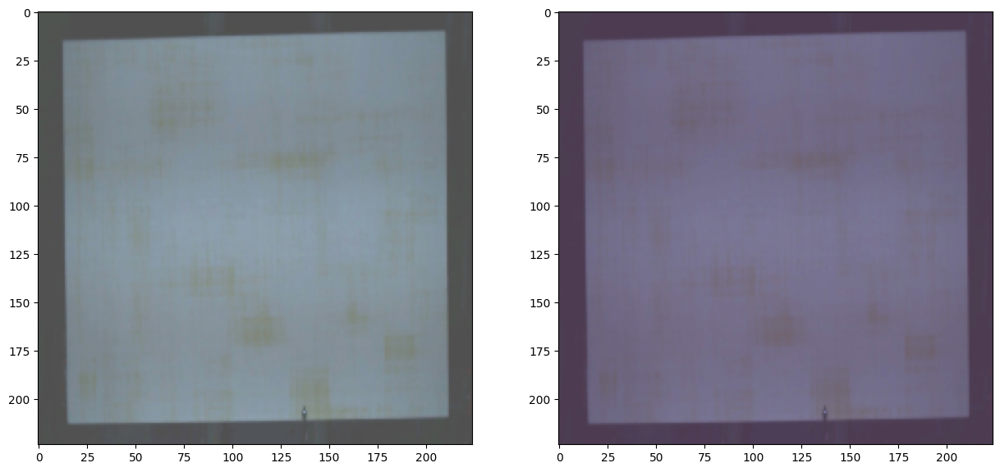

Threshold: 30895.55078125 MaxValue: 17927.53125
Directory: anomaly, Anomaly detected: False


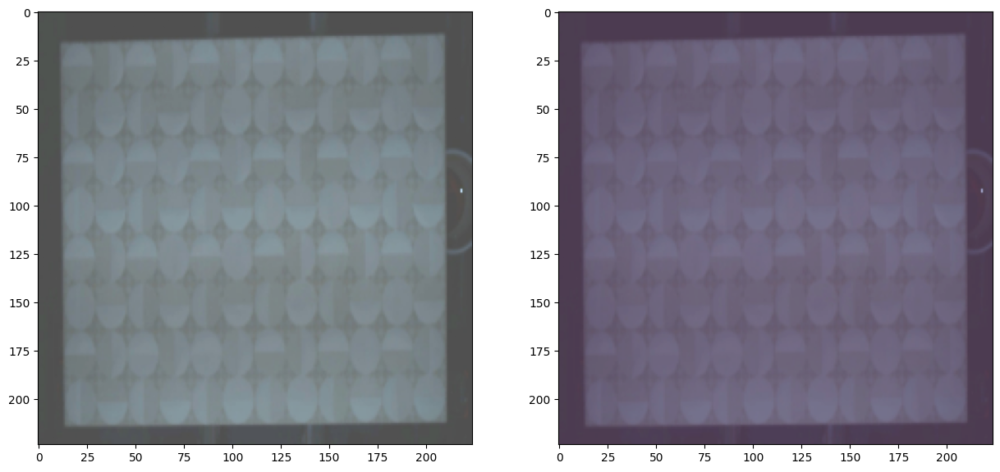

Threshold: 30895.55078125 MaxValue: 18087.296875
Directory: good, Anomaly detected: False


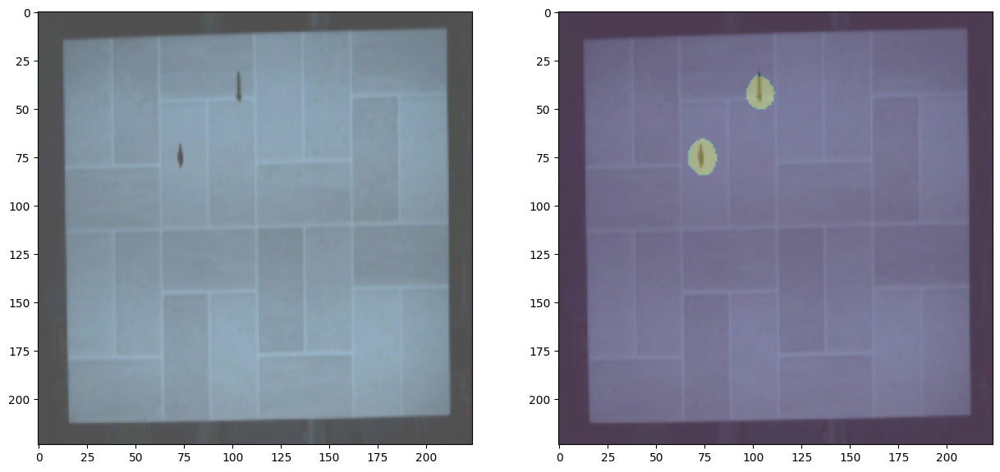

Threshold: 30895.55078125 MaxValue: 67907.890625
Directory: anomaly, Anomaly detected: True


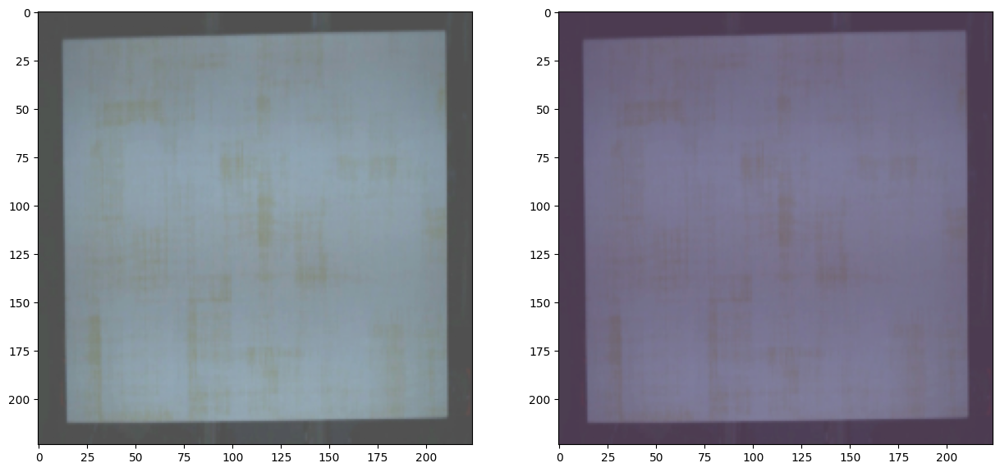

Threshold: 30895.55078125 MaxValue: 16120.791015625
Directory: good, Anomaly detected: False


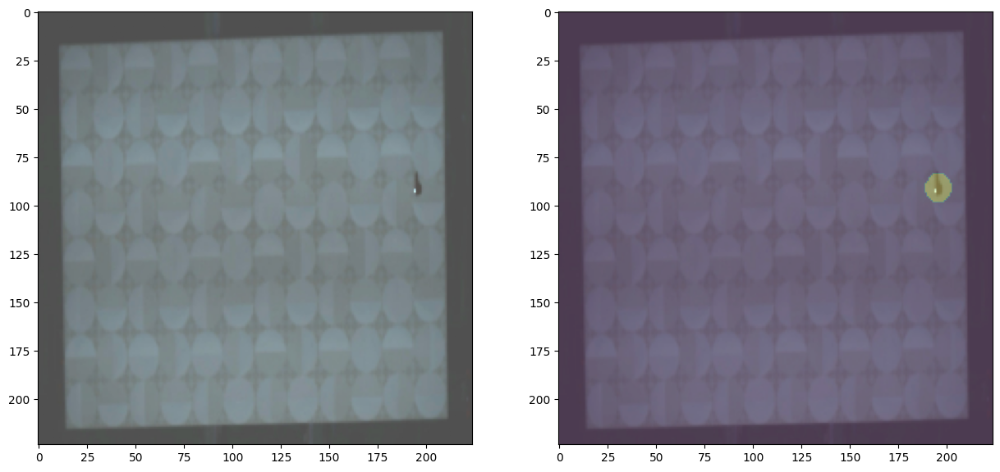

Threshold: 30895.55078125 MaxValue: 59602.7265625
Directory: anomaly, Anomaly detected: True


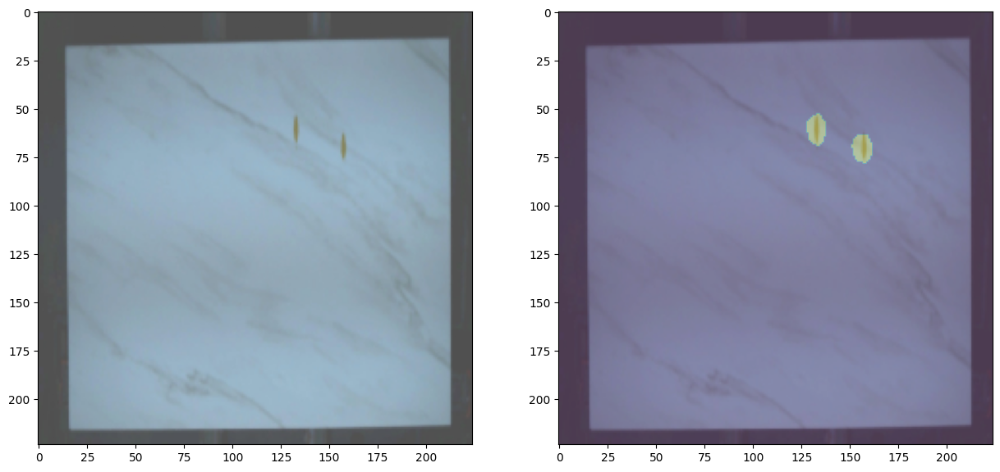

Threshold: 30895.55078125 MaxValue: 46727.66796875
Directory: anomaly, Anomaly detected: True


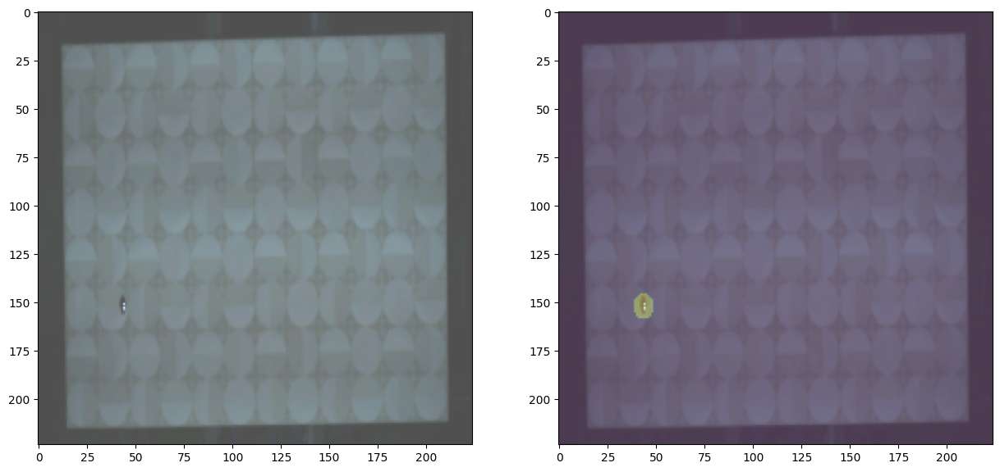

Threshold: 30895.55078125 MaxValue: 48443.984375
Directory: anomaly, Anomaly detected: True


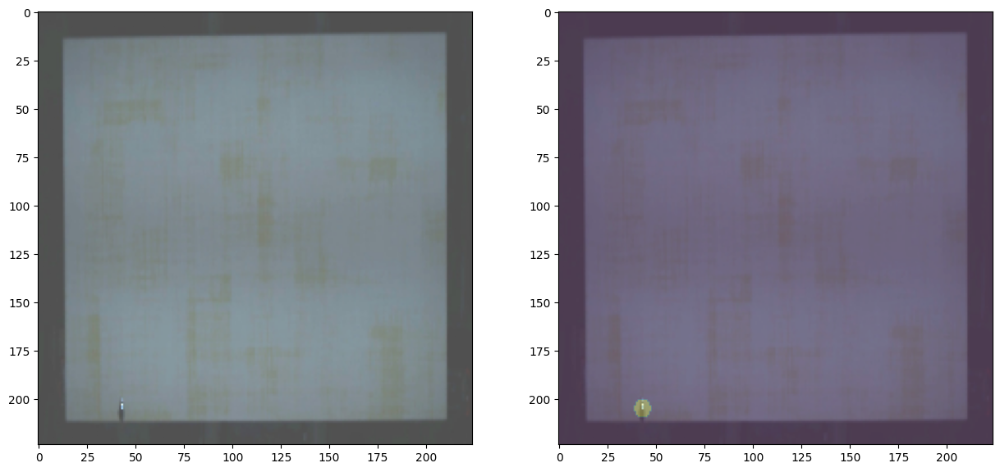

Threshold: 30895.55078125 MaxValue: 43455.78125
Directory: anomaly, Anomaly detected: True


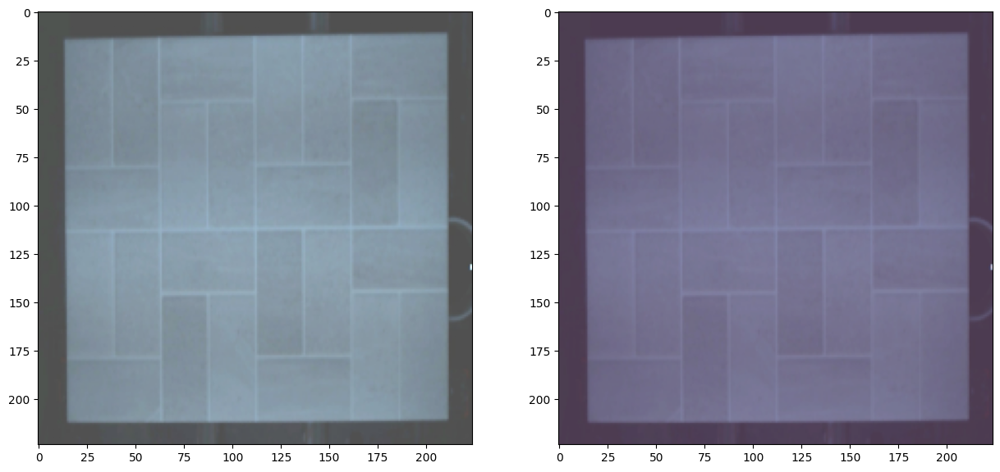

Threshold: 30895.55078125 MaxValue: 25955.89453125
Directory: good, Anomaly detected: False


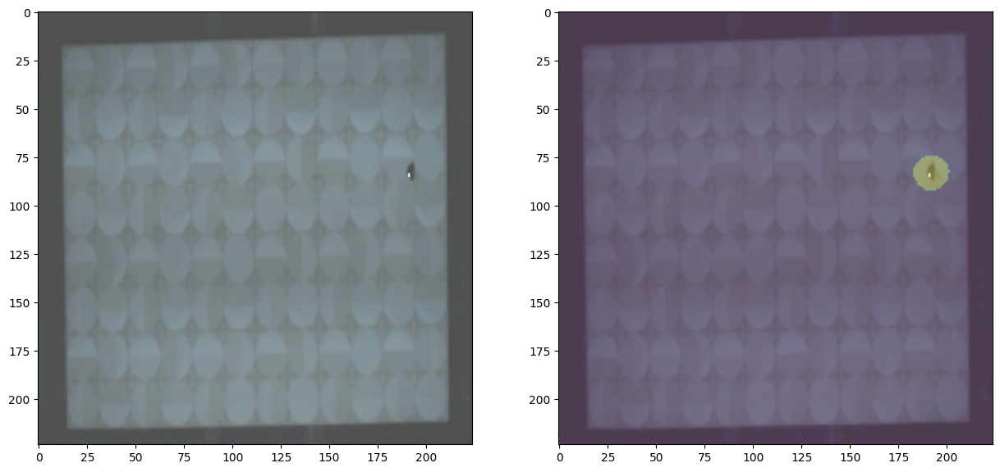

Threshold: 30895.55078125 MaxValue: 77569.953125
Directory: anomaly, Anomaly detected: True


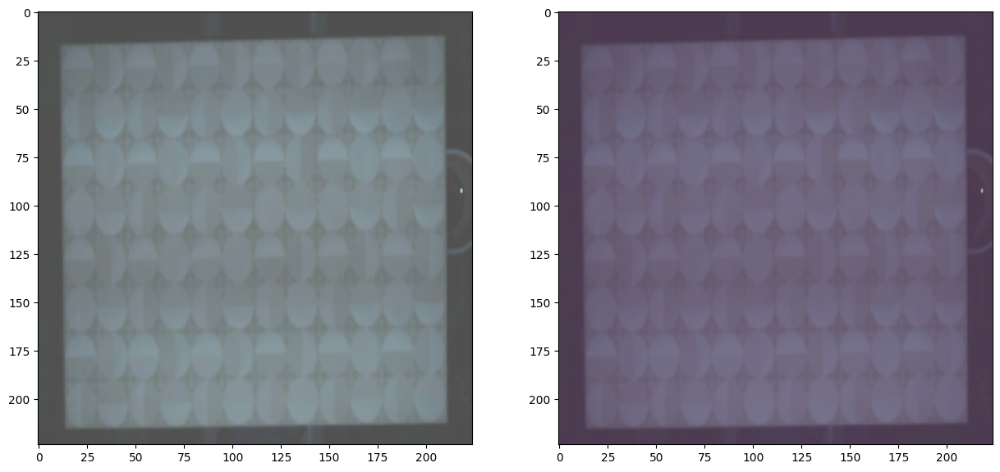

Threshold: 30895.55078125 MaxValue: 18936.568359375
Directory: good, Anomaly detected: False


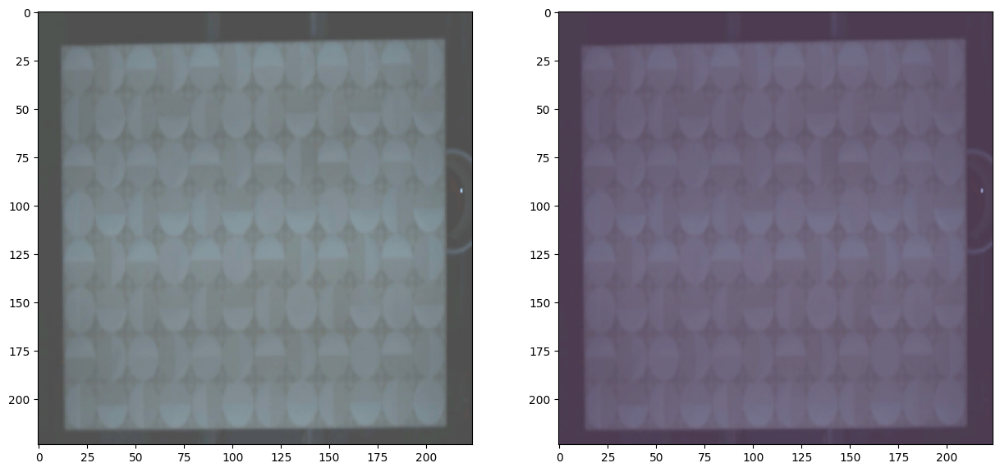

Threshold: 30895.55078125 MaxValue: 16528.15234375
Directory: good, Anomaly detected: False


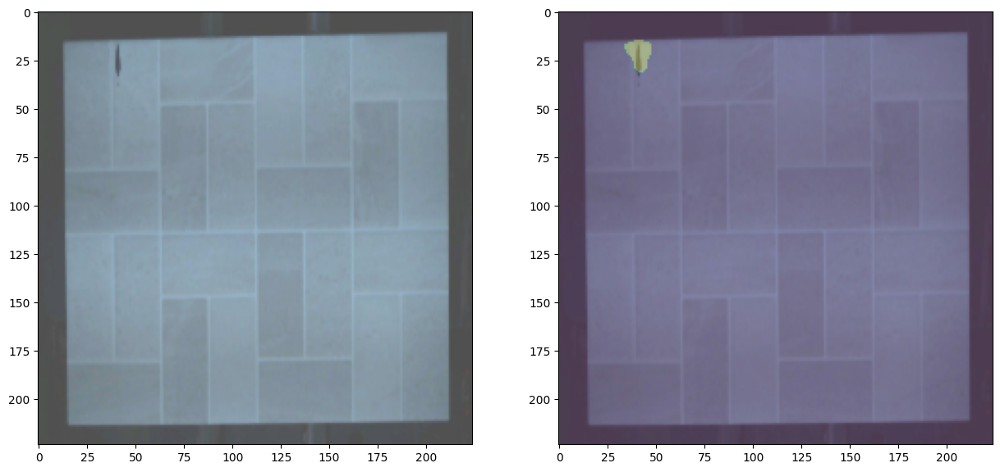

Threshold: 30895.55078125 MaxValue: 41127.99609375
Directory: anomaly, Anomaly detected: True


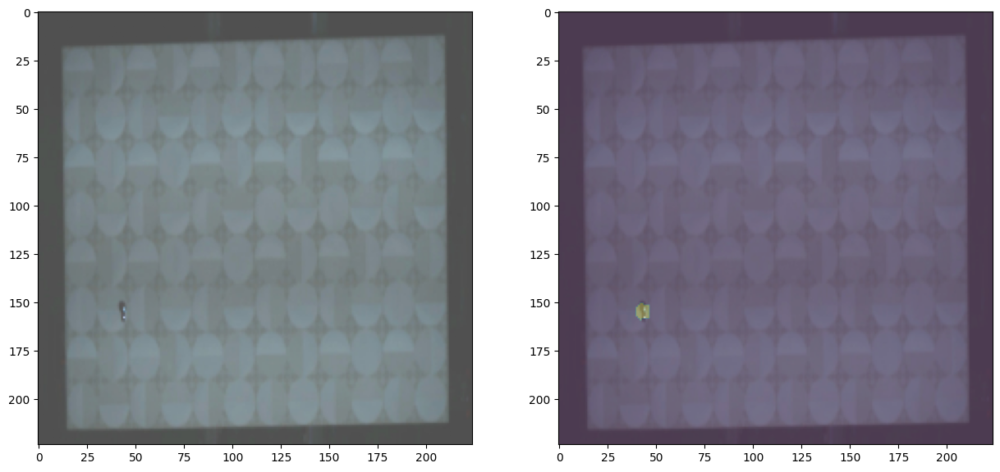

Threshold: 30895.55078125 MaxValue: 39427.46875
Directory: anomaly, Anomaly detected: True


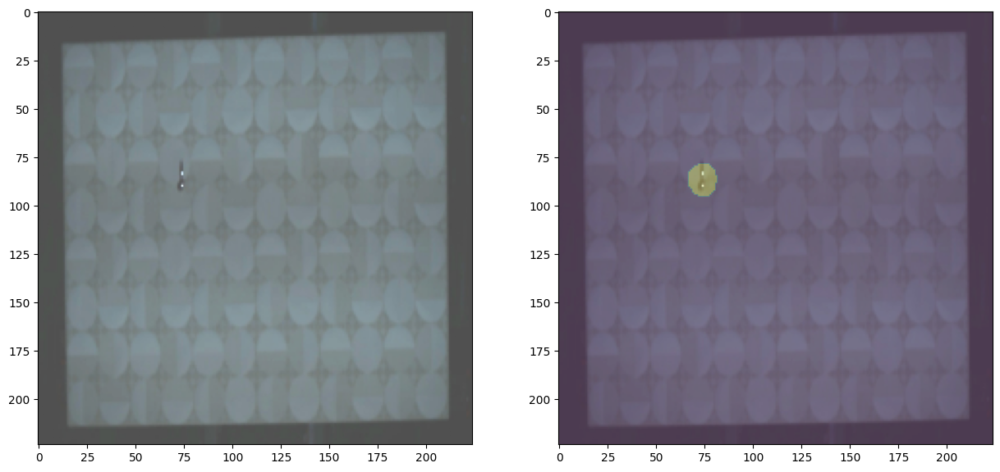

Threshold: 30895.55078125 MaxValue: 61324.5078125
Directory: anomaly, Anomaly detected: True


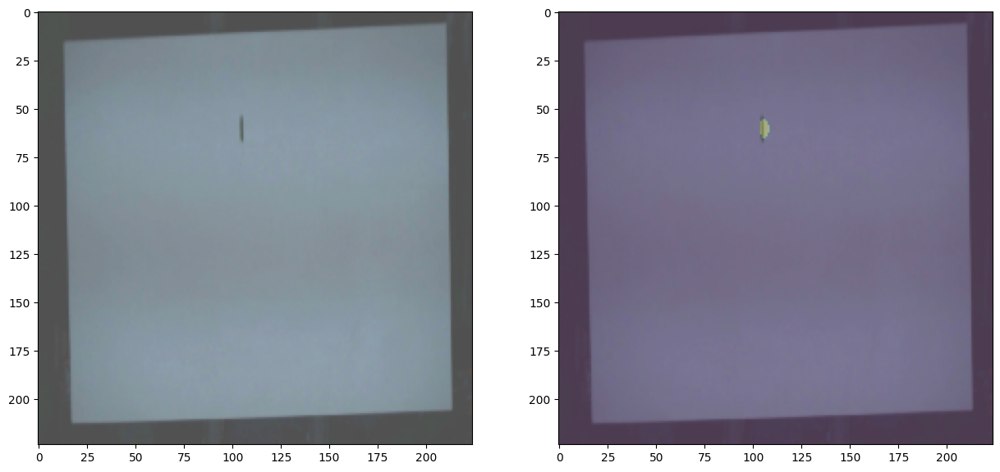

Threshold: 30895.55078125 MaxValue: 35613.43359375
Directory: anomaly, Anomaly detected: True


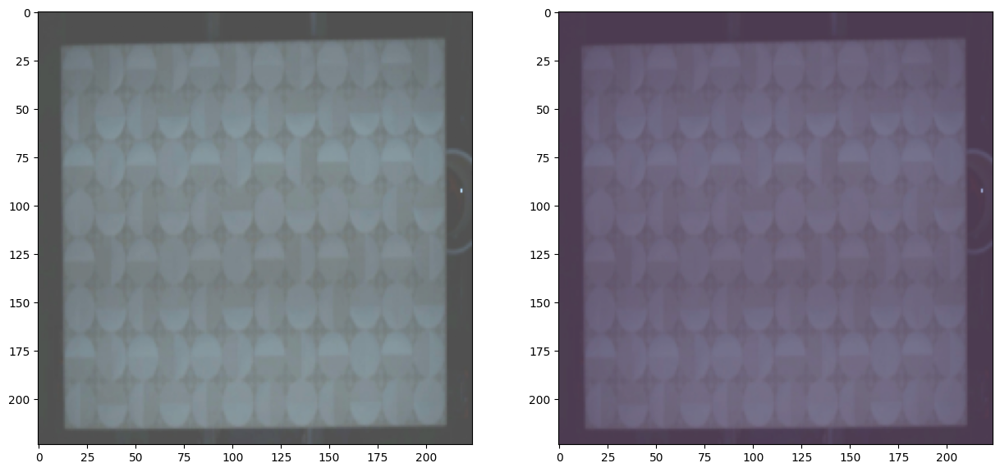

Threshold: 30895.55078125 MaxValue: 18166.296875
Directory: good, Anomaly detected: False


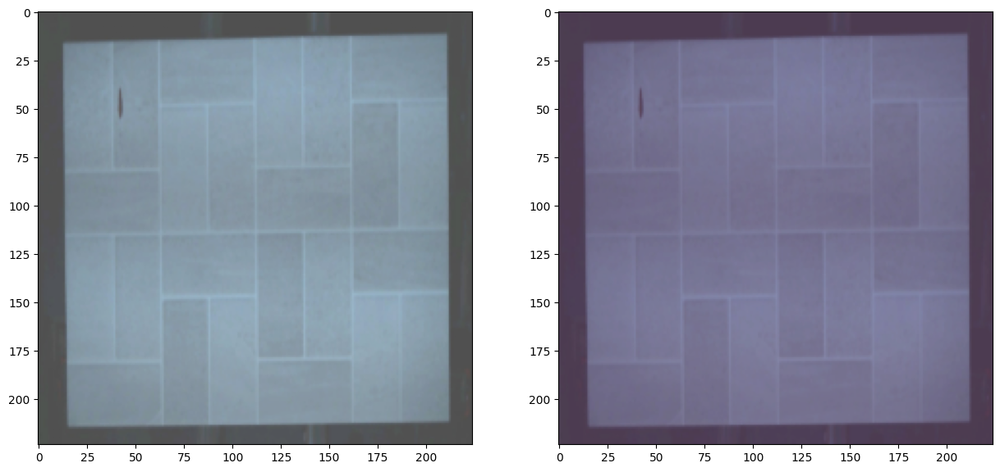

Threshold: 30895.55078125 MaxValue: 30527.140625
Directory: anomaly, Anomaly detected: True


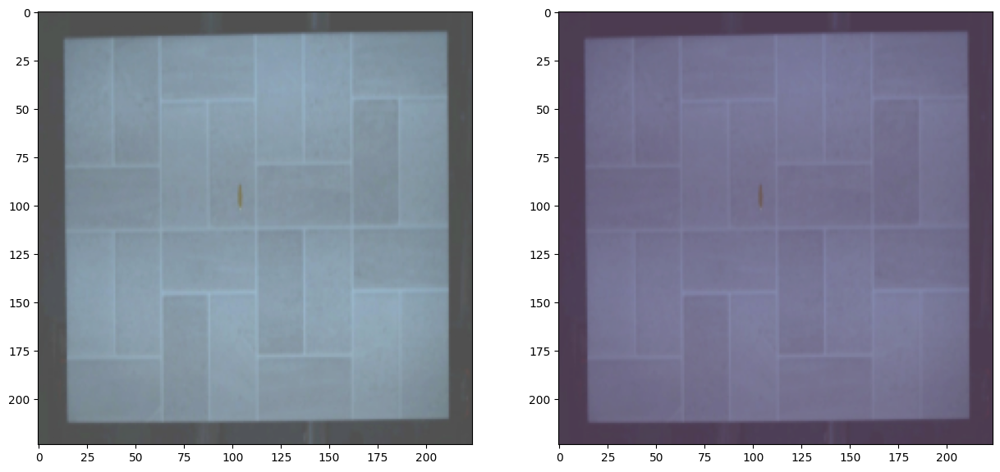

Threshold: 30895.55078125 MaxValue: 20475.943359375
Directory: anomaly, Anomaly detected: False


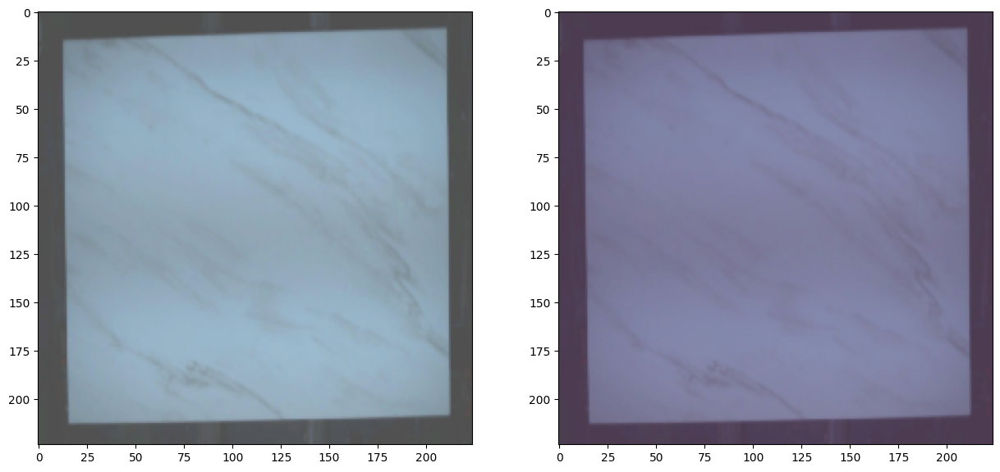

Threshold: 30895.55078125 MaxValue: 26029.58984375
Directory: good, Anomaly detected: False


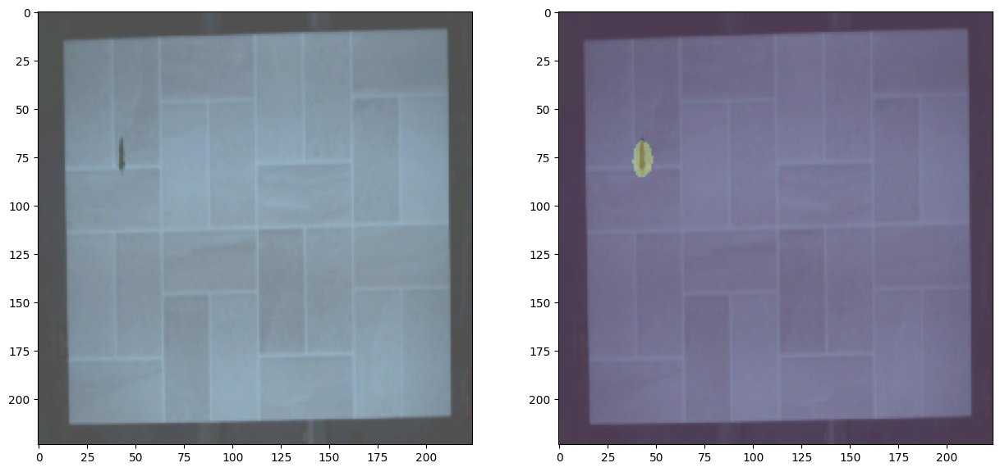

Threshold: 30895.55078125 MaxValue: 46975.7421875
Directory: anomaly, Anomaly detected: True


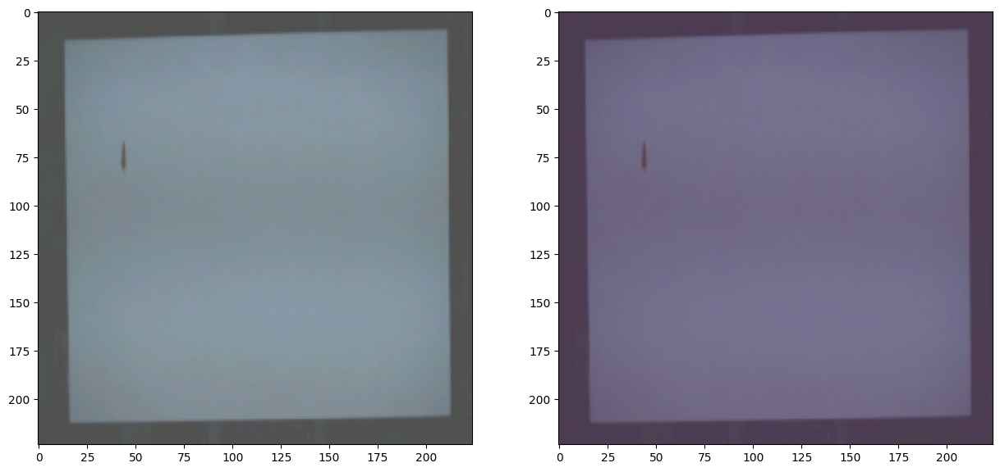

Threshold: 30895.55078125 MaxValue: 28871.142578125
Directory: anomaly, Anomaly detected: False


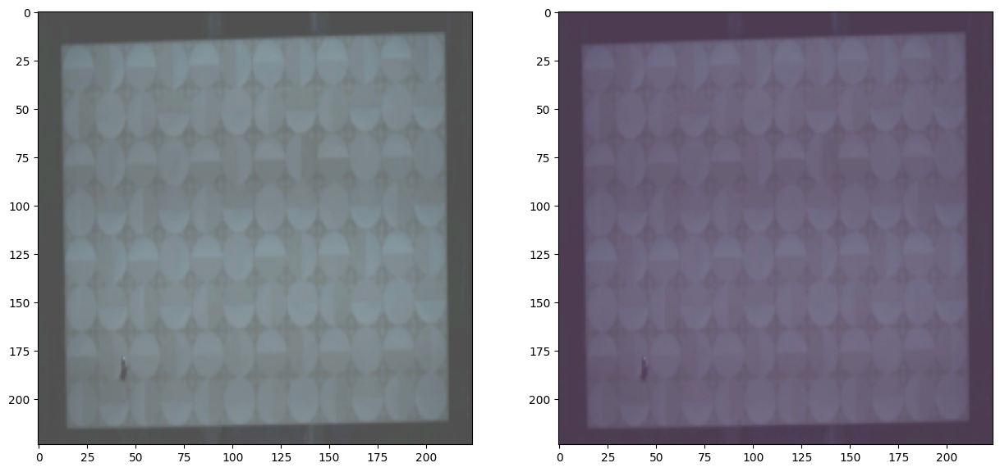

Threshold: 30895.55078125 MaxValue: 15141.642578125
Directory: anomaly, Anomaly detected: False


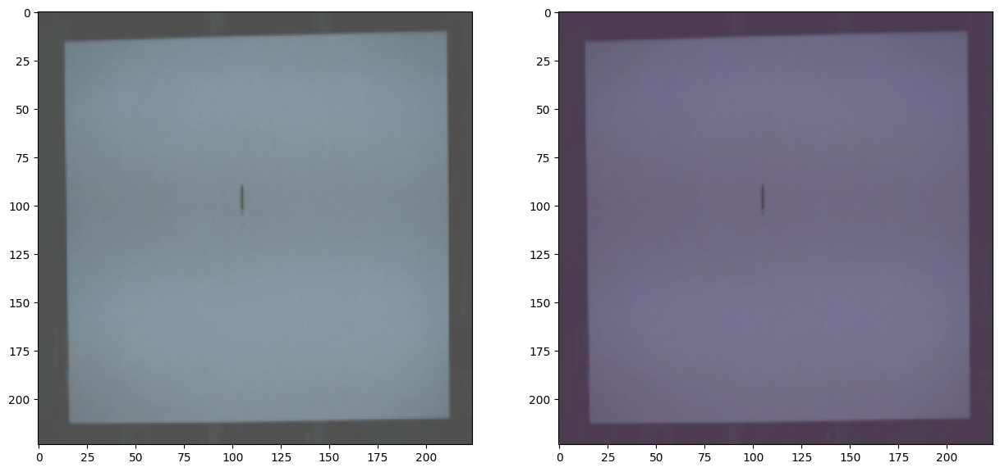

Threshold: 30895.55078125 MaxValue: 22255.77734375
Directory: anomaly, Anomaly detected: False


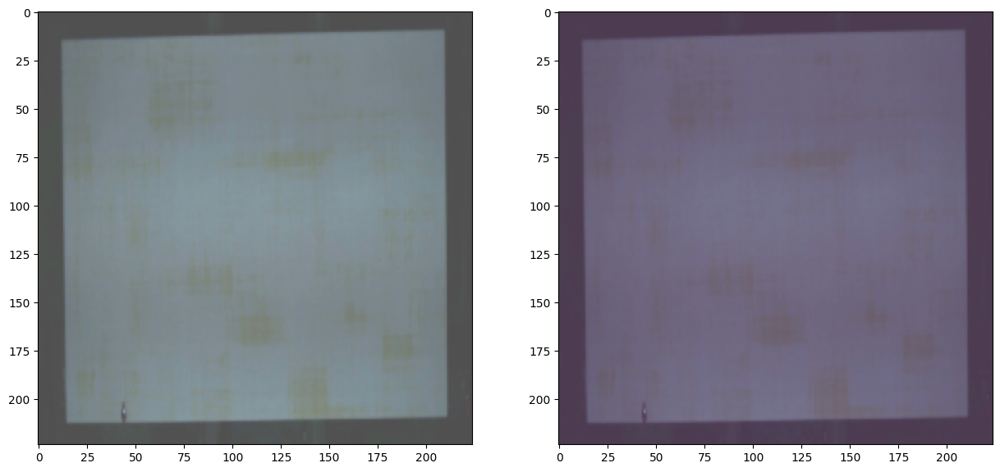

Threshold: 30895.55078125 MaxValue: 20362.4375
Directory: anomaly, Anomaly detected: False


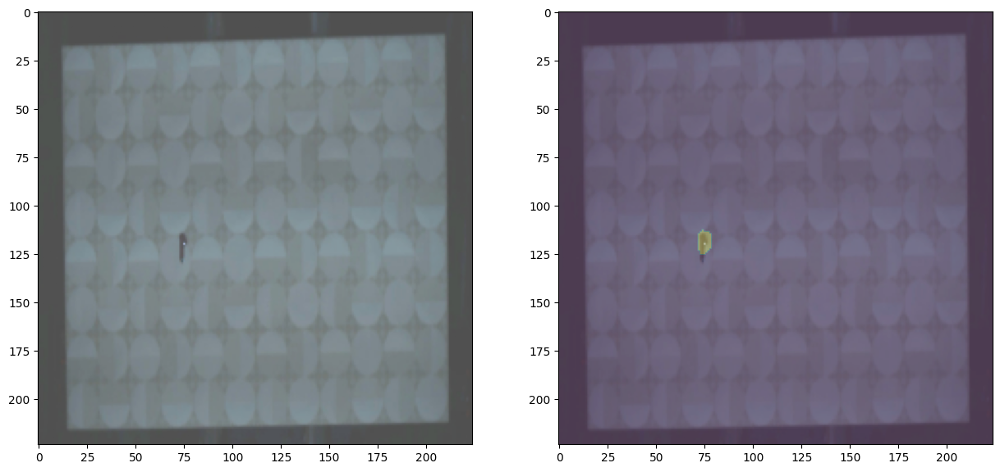

Threshold: 30895.55078125 MaxValue: 39678.671875
Directory: anomaly, Anomaly detected: True


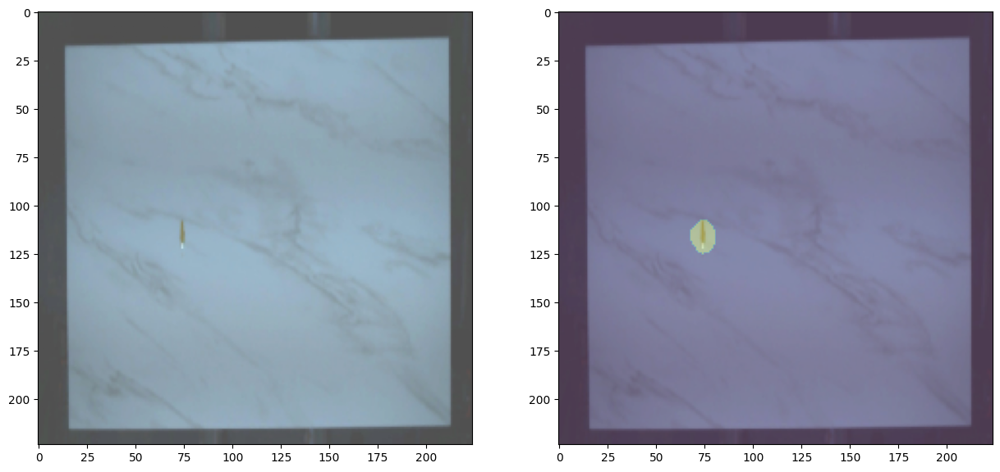

Threshold: 30895.55078125 MaxValue: 59104.171875
Directory: anomaly, Anomaly detected: True


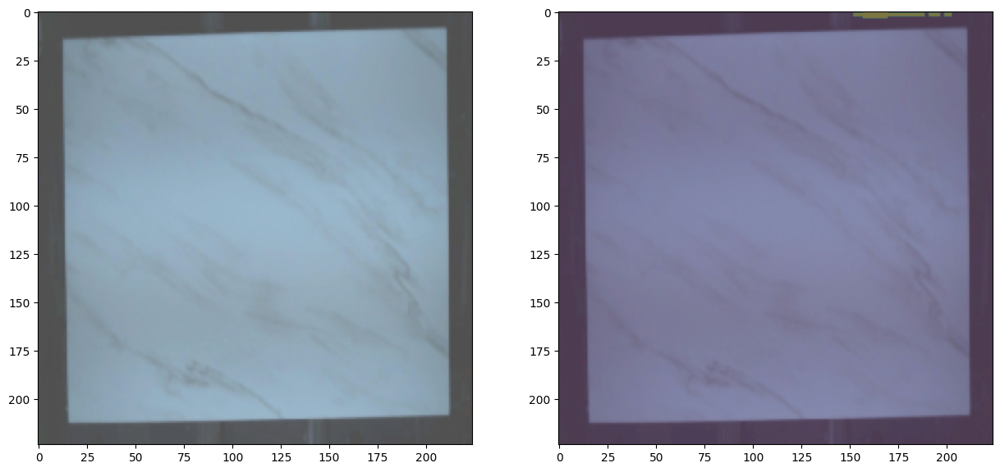

Threshold: 30895.55078125 MaxValue: 32758.14453125
Directory: good, Anomaly detected: True


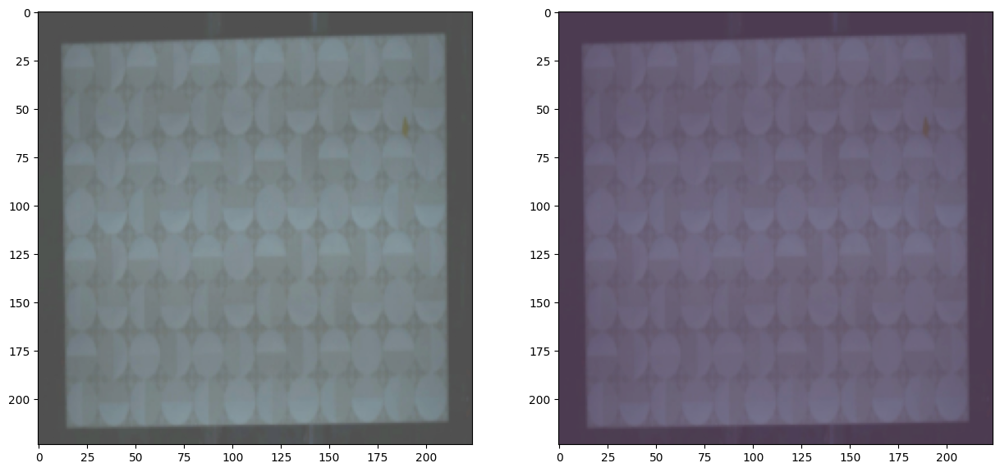

Threshold: 30895.55078125 MaxValue: 10319.3759765625
Directory: anomaly, Anomaly detected: False


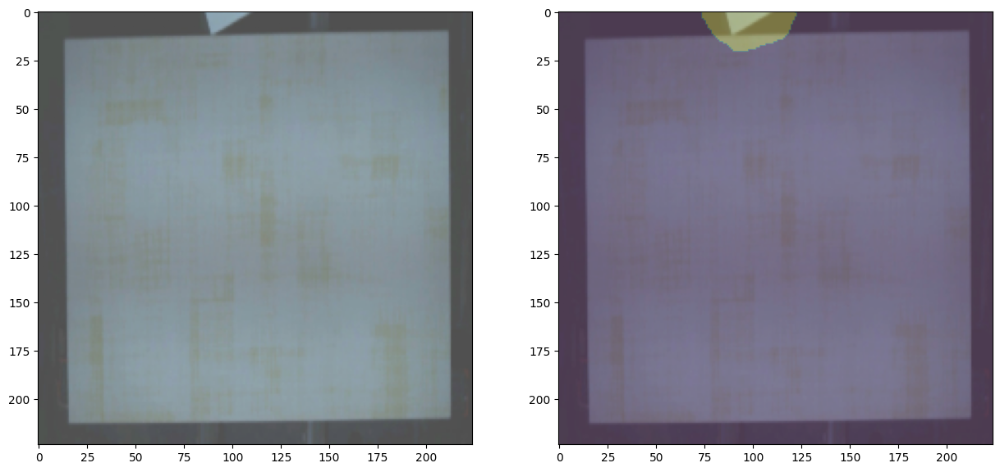

Threshold: 30895.55078125 MaxValue: 98127.8125
Directory: good, Anomaly detected: True


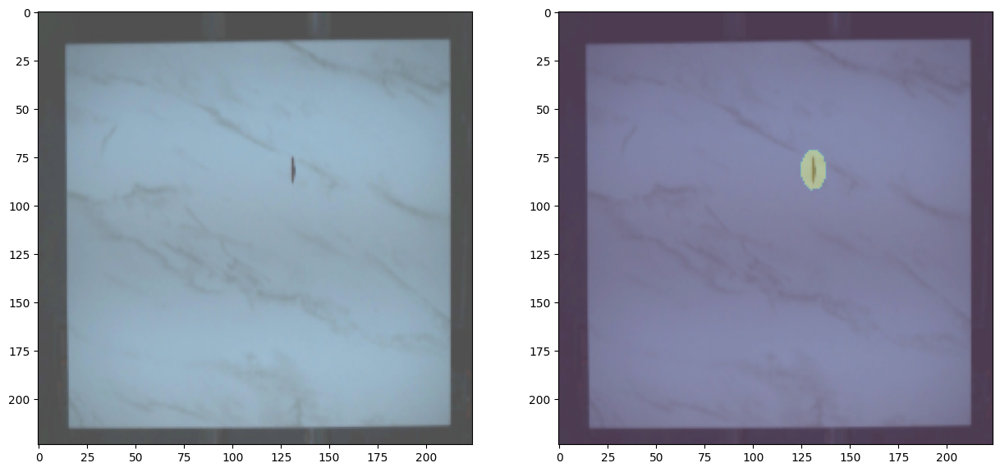

Threshold: 30895.55078125 MaxValue: 58557.42578125
Directory: anomaly, Anomaly detected: True


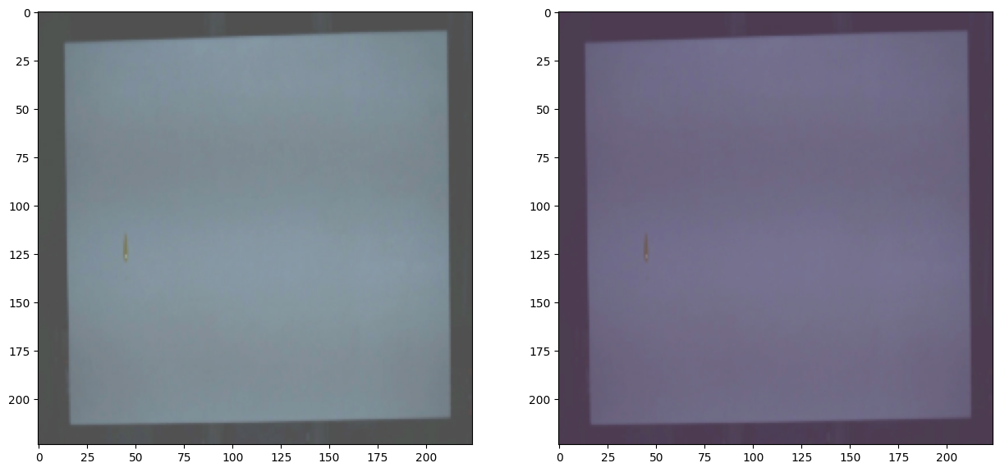

Threshold: 30895.55078125 MaxValue: 17888.4921875
Directory: anomaly, Anomaly detected: False


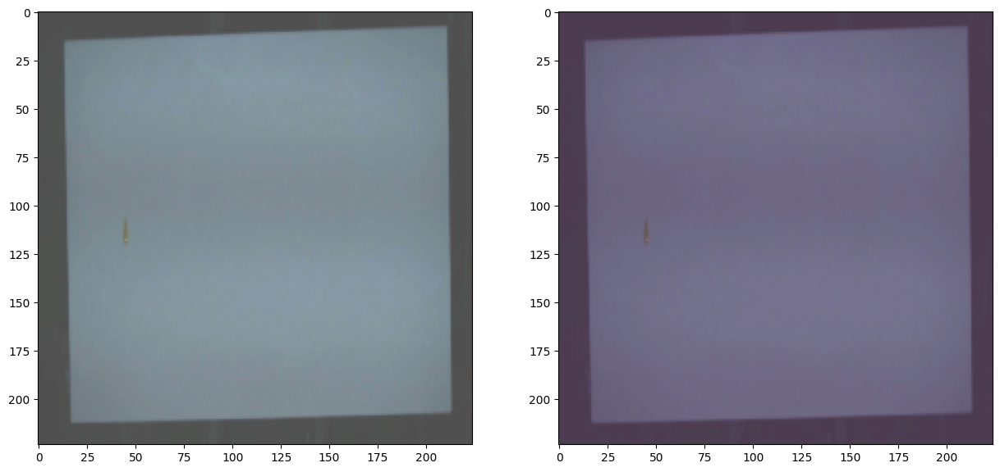

Threshold: 30895.55078125 MaxValue: 21019.779296875
Directory: anomaly, Anomaly detected: False


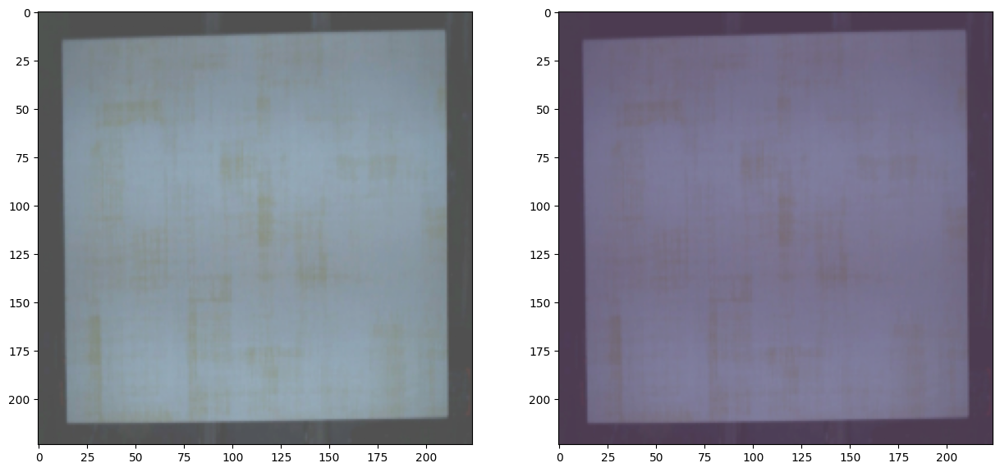

Threshold: 30895.55078125 MaxValue: 17425.240234375
Directory: good, Anomaly detected: False


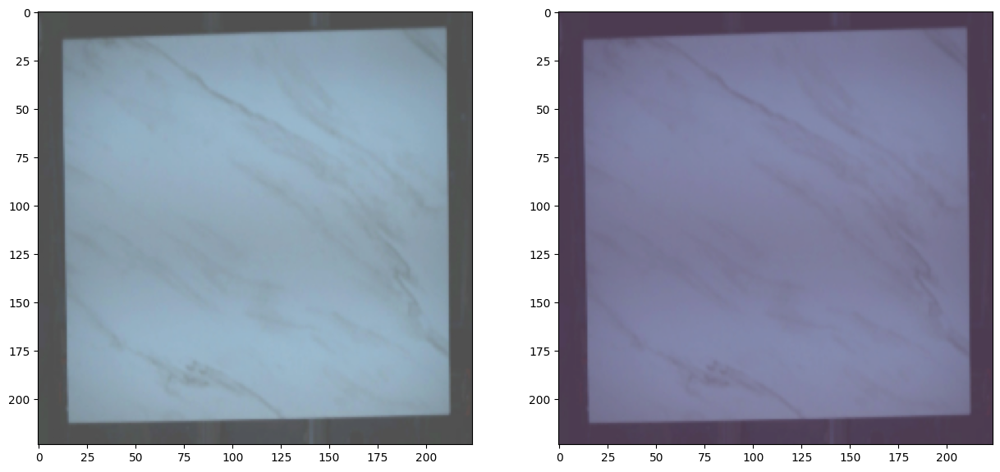

Threshold: 30895.55078125 MaxValue: 27365.4453125
Directory: good, Anomaly detected: False


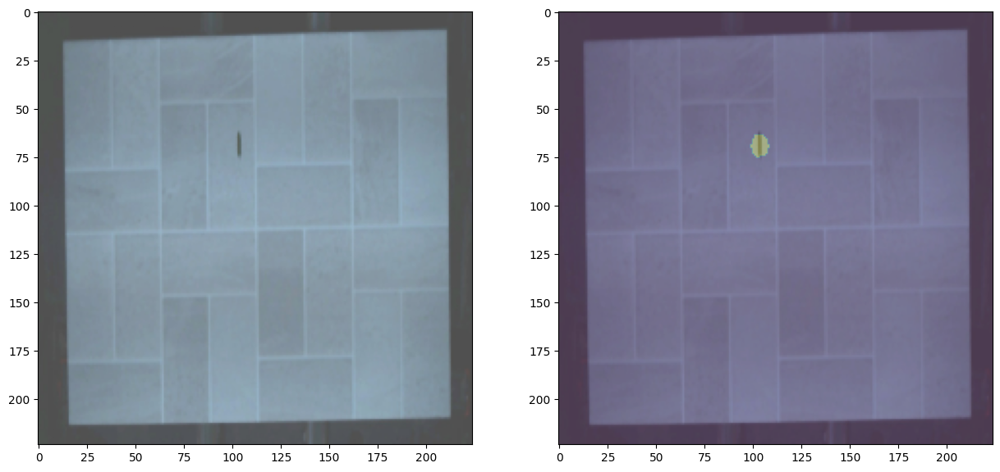

Threshold: 30895.55078125 MaxValue: 38790.9375
Directory: anomaly, Anomaly detected: True


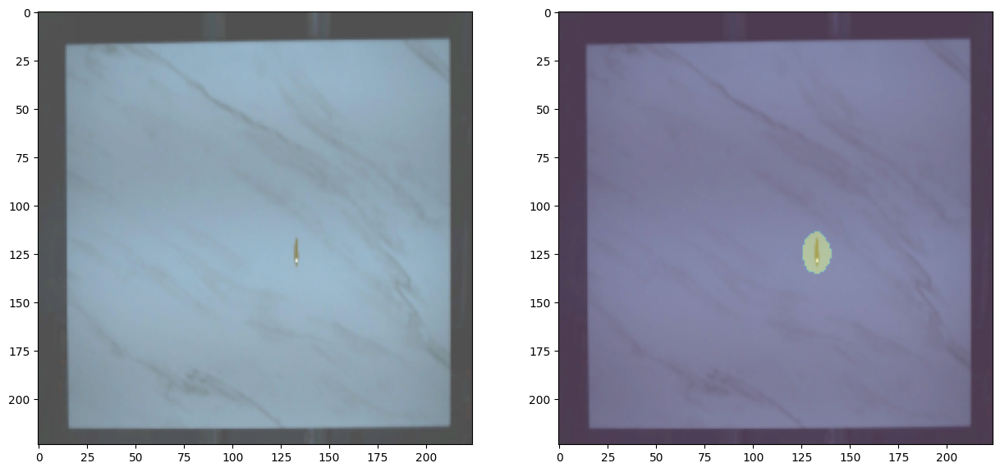

Threshold: 30895.55078125 MaxValue: 67440.3828125
Directory: anomaly, Anomaly detected: True


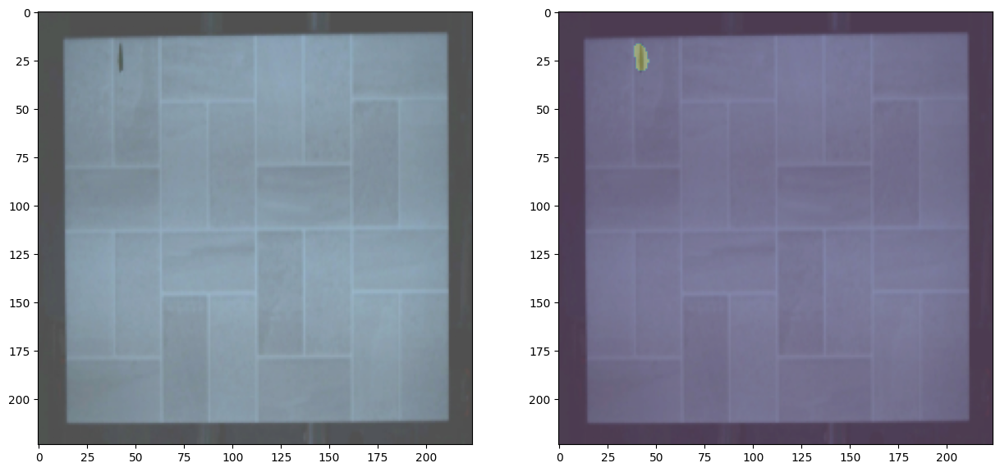

Threshold: 30895.55078125 MaxValue: 37571.05859375
Directory: anomaly, Anomaly detected: True


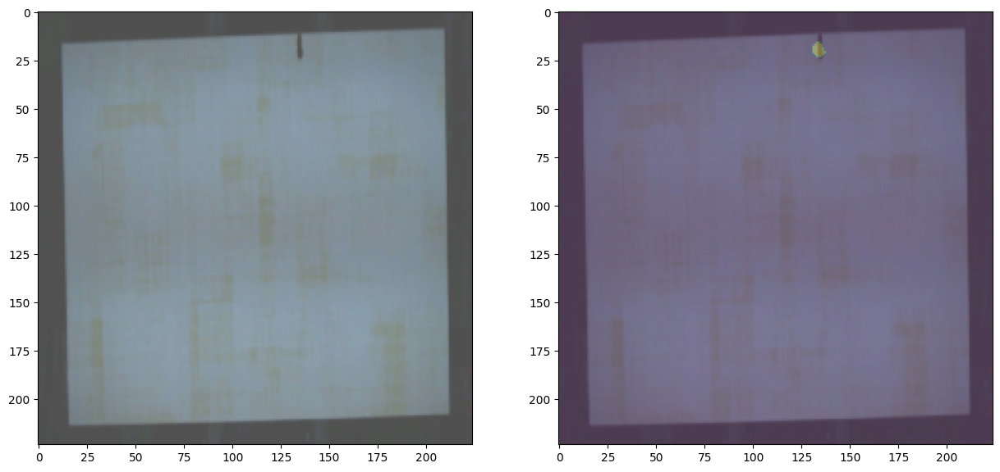

Threshold: 30895.55078125 MaxValue: 36034.28125
Directory: anomaly, Anomaly detected: True


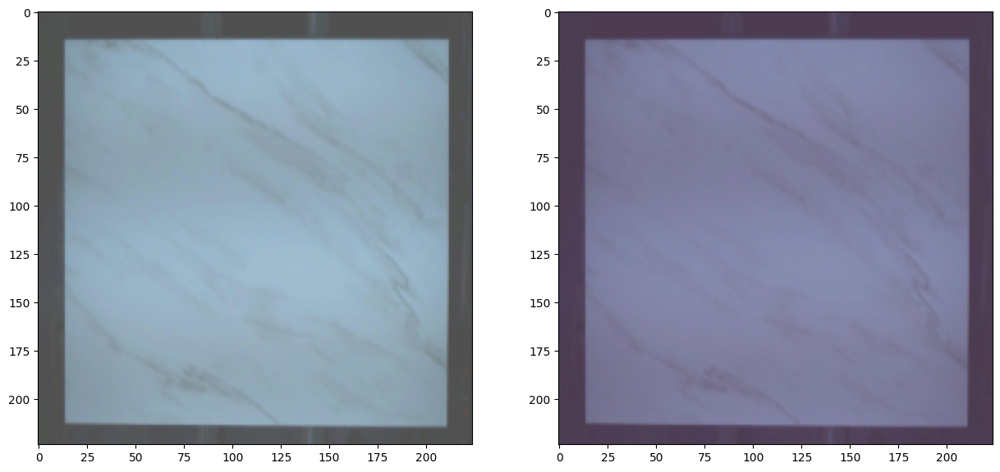

Threshold: 30895.55078125 MaxValue: 23303.232421875
Directory: good, Anomaly detected: False


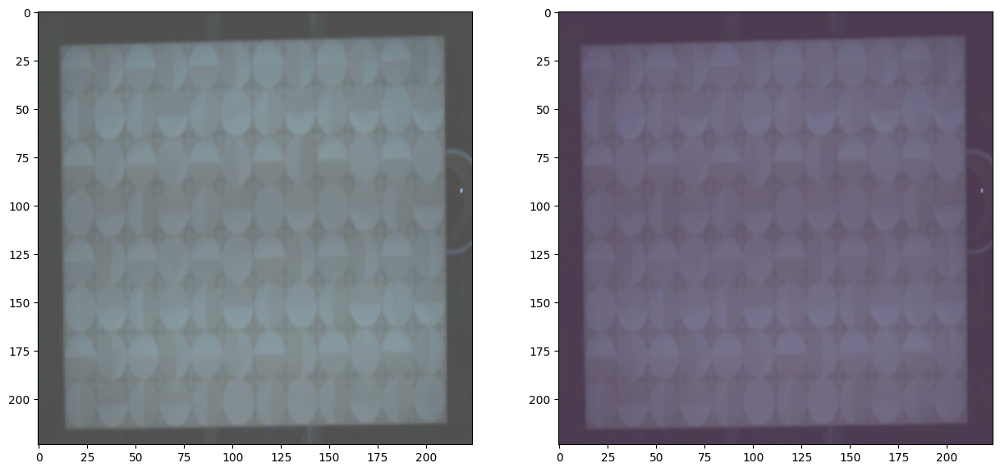

Threshold: 30895.55078125 MaxValue: 13951.806640625
Directory: good, Anomaly detected: False


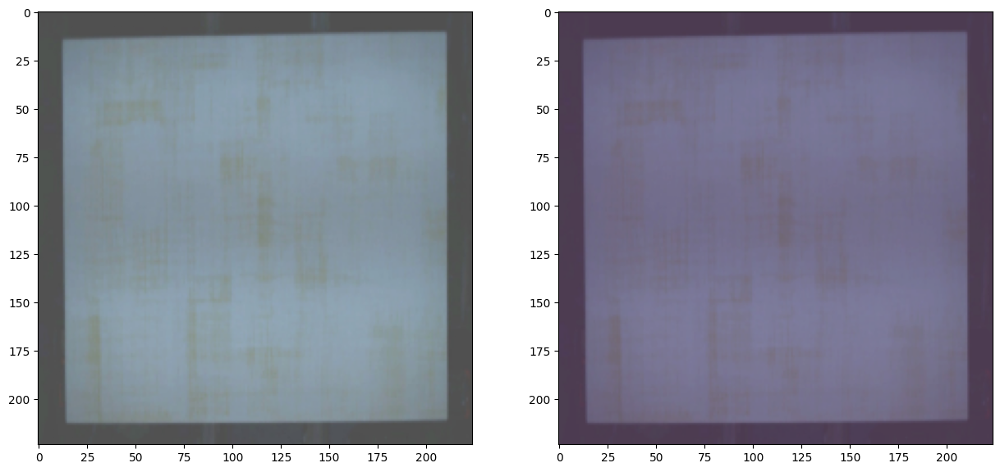

Threshold: 30895.55078125 MaxValue: 17763.30078125
Directory: good, Anomaly detected: False


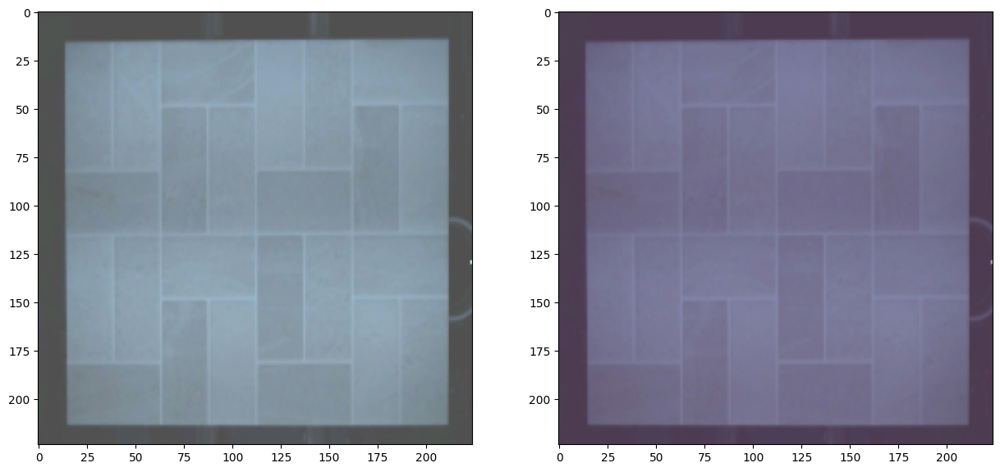

Threshold: 30895.55078125 MaxValue: 21003.609375
Directory: good, Anomaly detected: False


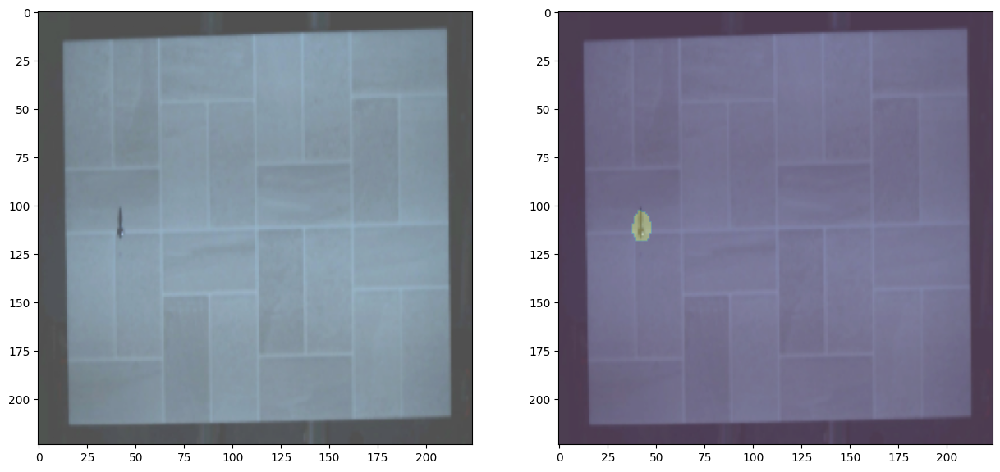

Threshold: 30895.55078125 MaxValue: 47187.87109375
Directory: anomaly, Anomaly detected: True


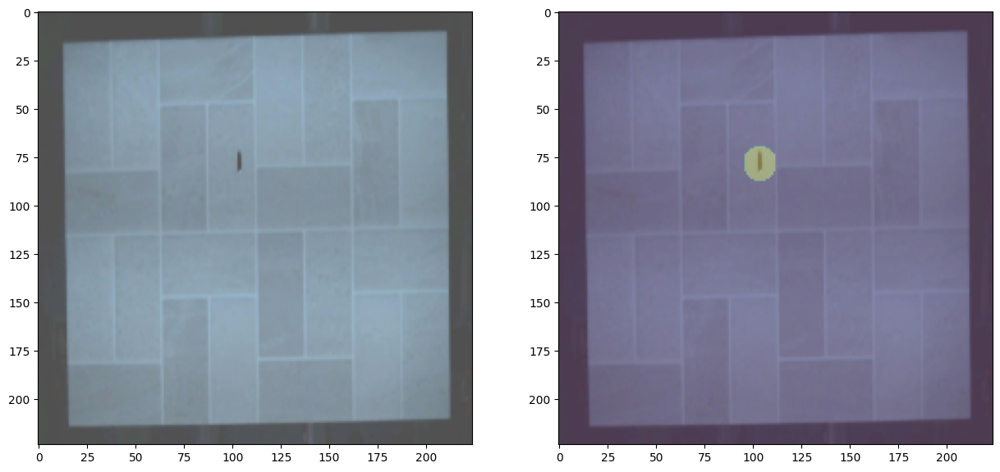

Threshold: 30895.55078125 MaxValue: 63897.48828125
Directory: anomaly, Anomaly detected: True


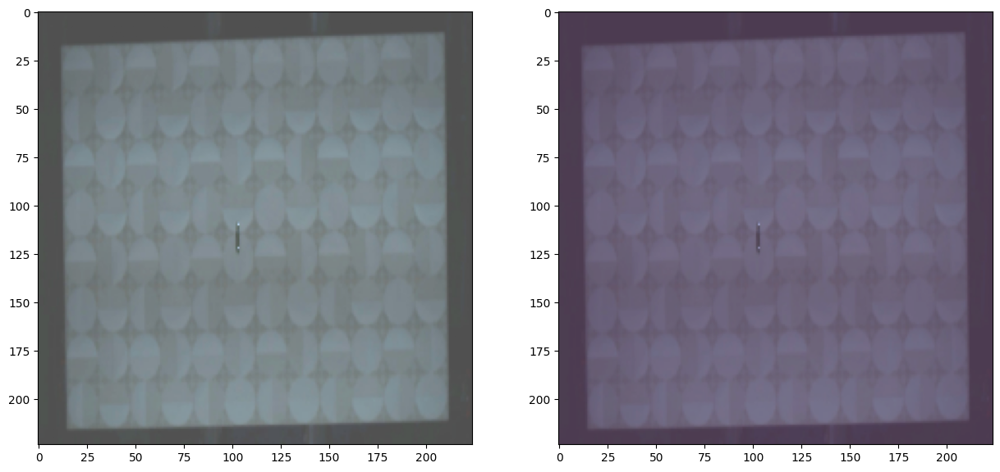

Threshold: 30895.55078125 MaxValue: 27201.0859375
Directory: anomaly, Anomaly detected: False


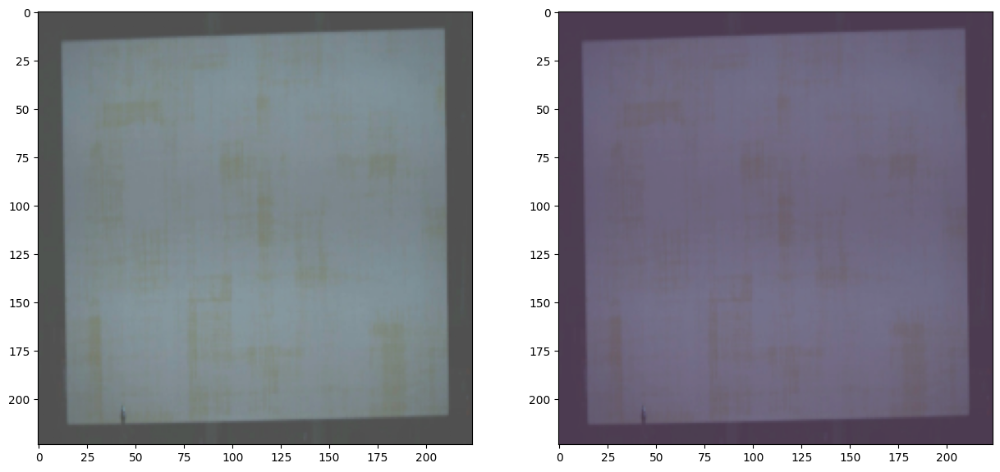

Threshold: 30895.55078125 MaxValue: 16046.5869140625
Directory: anomaly, Anomaly detected: False


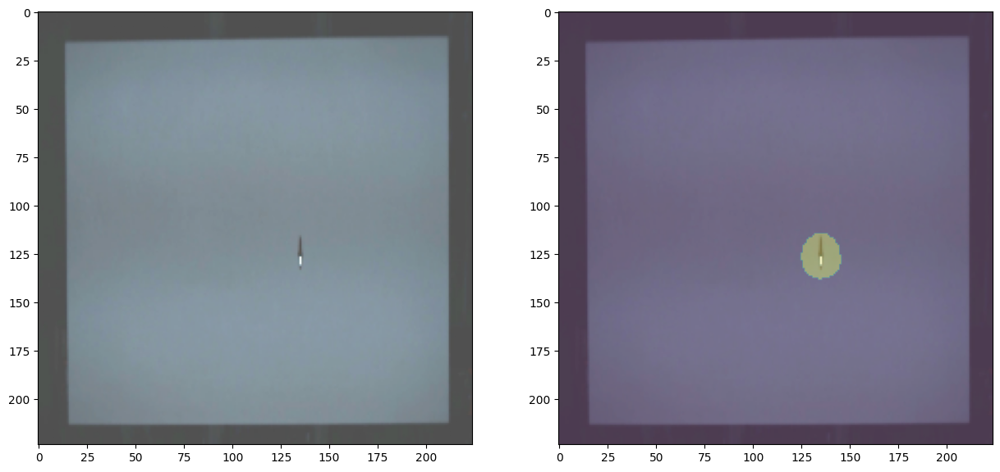

Threshold: 30895.55078125 MaxValue: 83337.2109375
Directory: anomaly, Anomaly detected: True


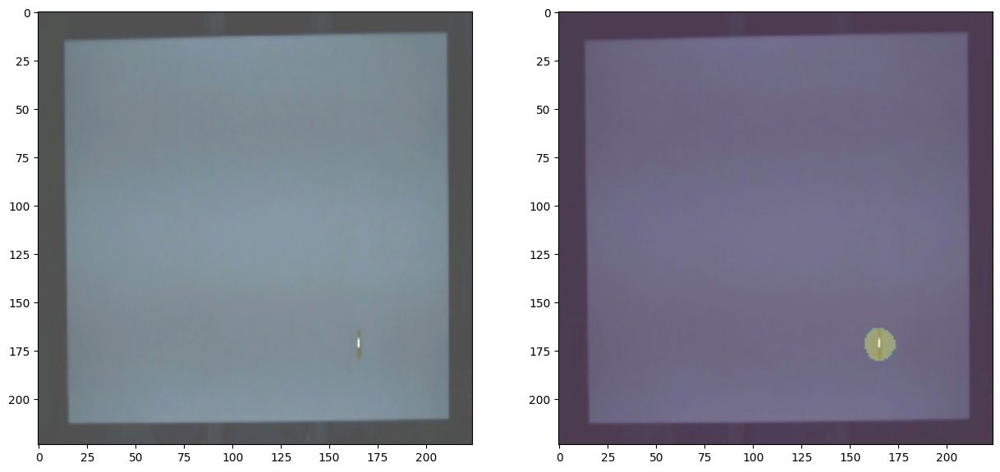

Threshold: 30895.55078125 MaxValue: 67702.34375
Directory: anomaly, Anomaly detected: True


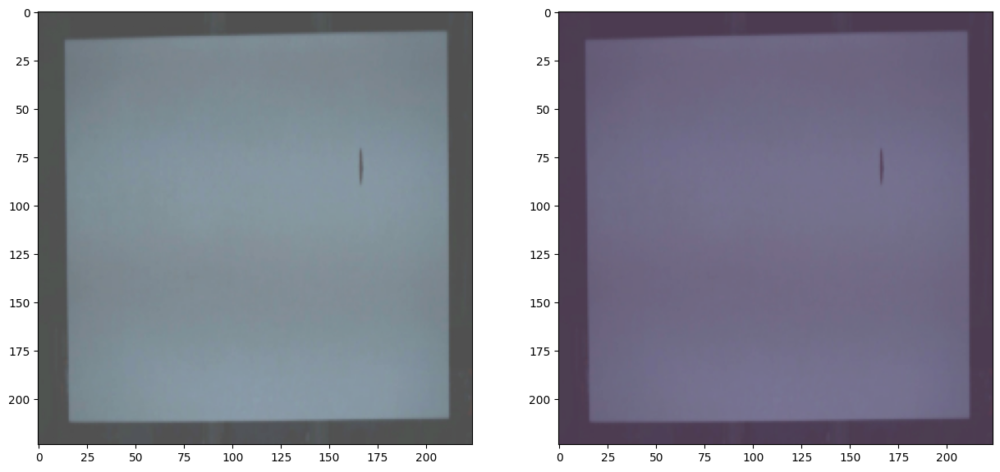

Threshold: 30895.55078125 MaxValue: 29383.873046875
Directory: anomaly, Anomaly detected: False


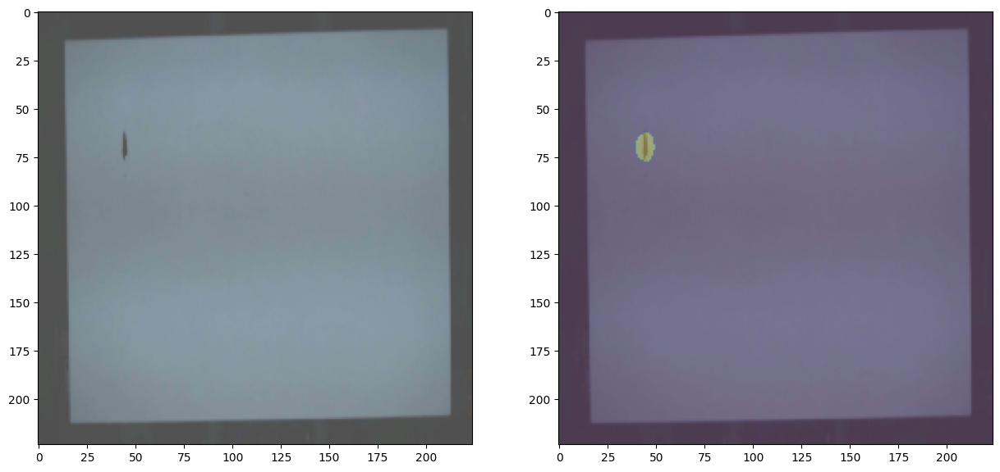

Threshold: 30895.55078125 MaxValue: 45680.81640625
Directory: anomaly, Anomaly detected: True


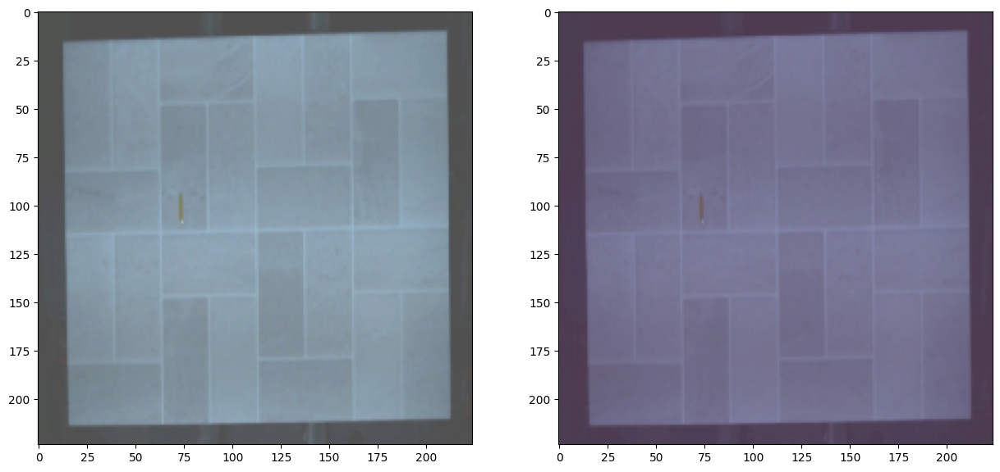

Threshold: 30895.55078125 MaxValue: 24332.517578125
Directory: anomaly, Anomaly detected: False


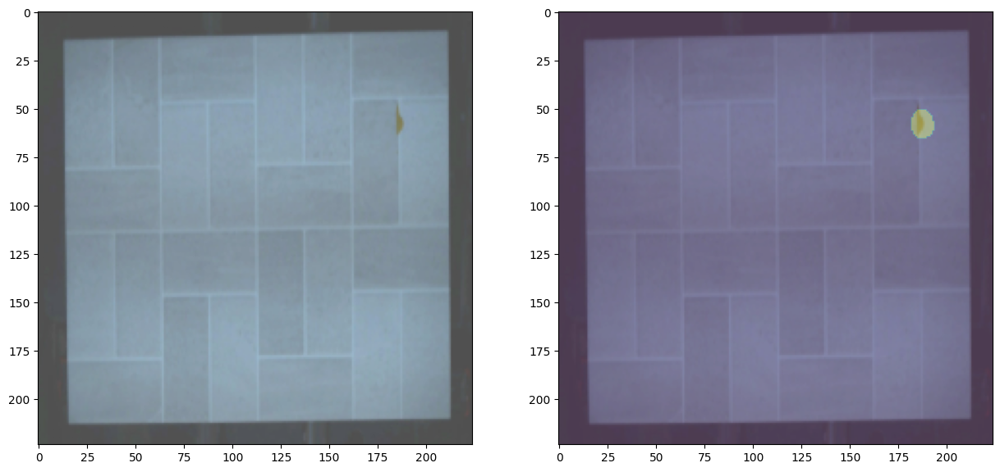

Threshold: 30895.55078125 MaxValue: 52074.17578125
Directory: anomaly, Anomaly detected: True


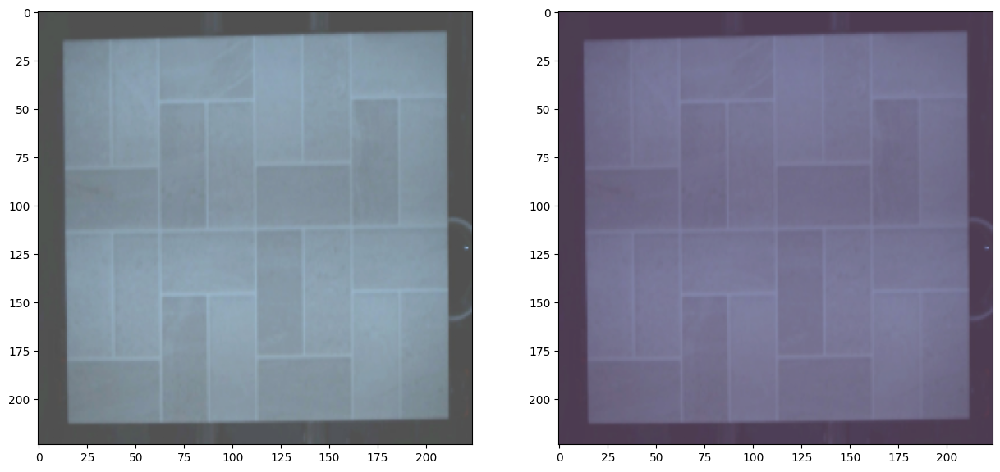

Threshold: 30895.55078125 MaxValue: 22012.552734375
Directory: good, Anomaly detected: False


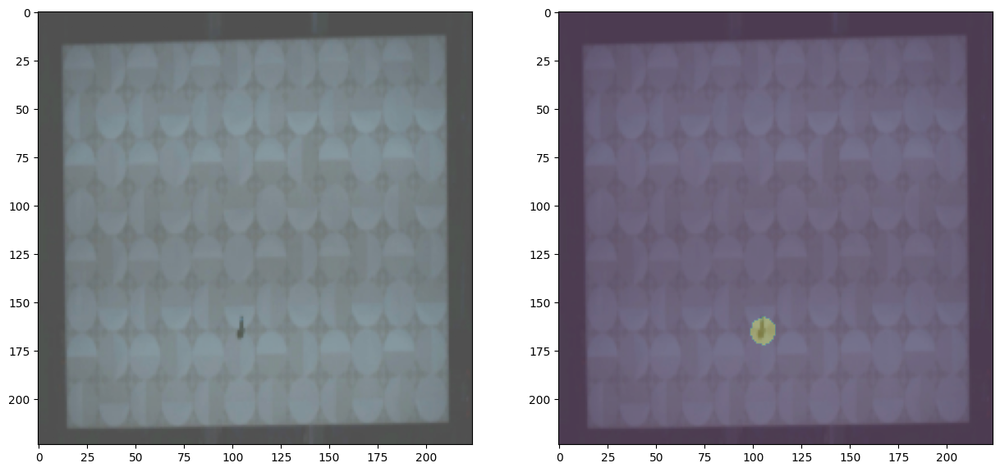

Threshold: 30895.55078125 MaxValue: 50250.46875
Directory: anomaly, Anomaly detected: True


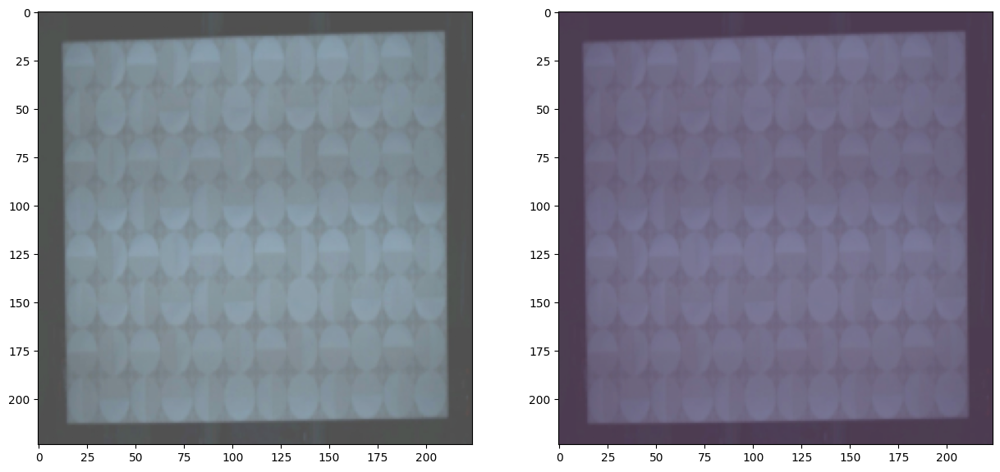

Threshold: 30895.55078125 MaxValue: 17114.005859375
Directory: good, Anomaly detected: False


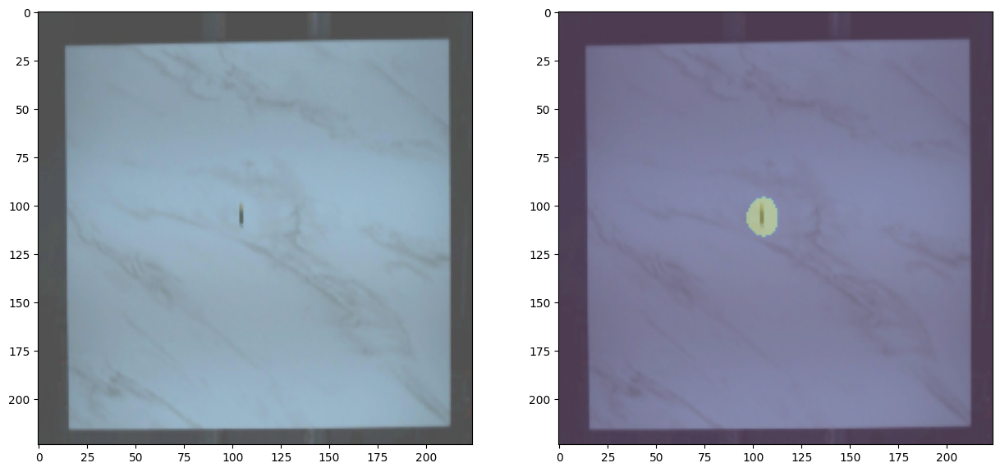

Threshold: 30895.55078125 MaxValue: 70467.390625
Directory: anomaly, Anomaly detected: True


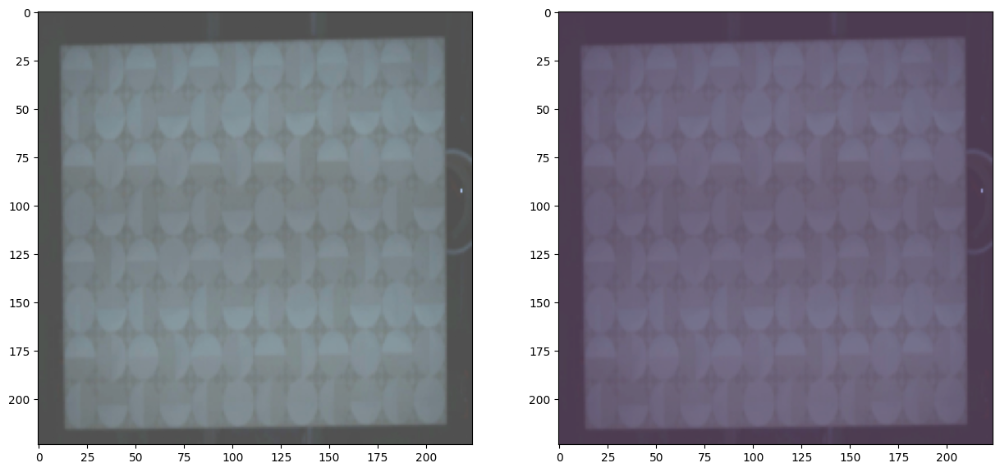

Threshold: 30895.55078125 MaxValue: 14674.6904296875
Directory: good, Anomaly detected: False


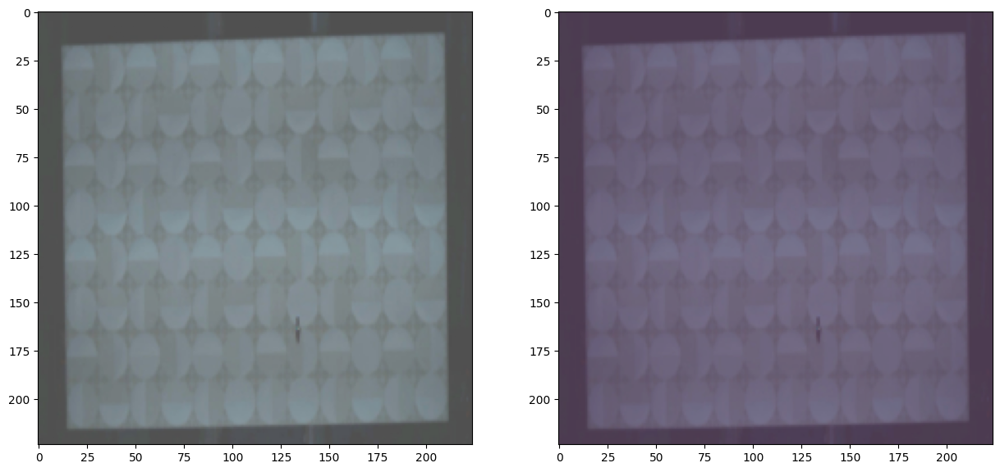

Threshold: 30895.55078125 MaxValue: 12038.2880859375
Directory: anomaly, Anomaly detected: False


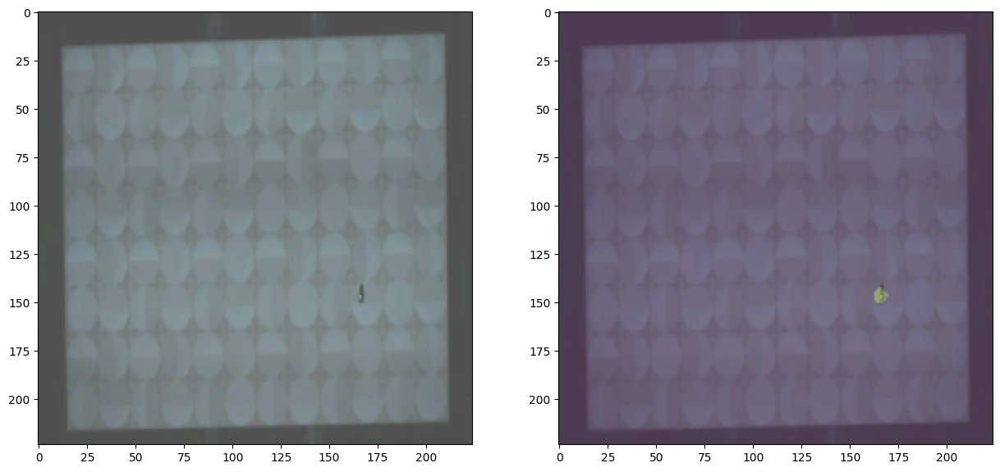

Threshold: 30895.55078125 MaxValue: 38719.0625
Directory: anomaly, Anomaly detected: True


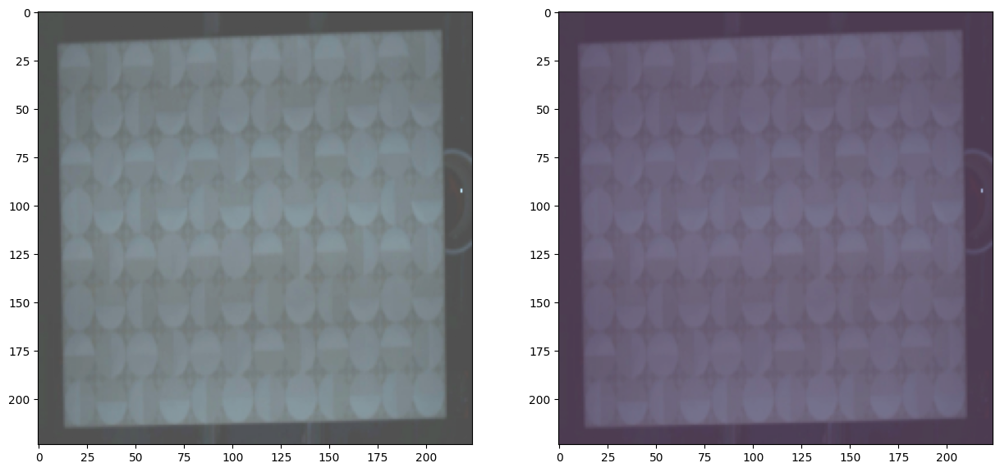

Threshold: 30895.55078125 MaxValue: 19649.53125
Directory: good, Anomaly detected: False
True Labels: [0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0]
Predictions: [0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0]


In [ ]:
# Importar las bibliotecas necesarias
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np
import matplotlib.pyplot as plt
from skimage.transform import resize

# Crear el generador de datos de prueba
test_datagen = ImageDataGenerator(rescale=1. / 255, data_format='channels_last')
test_generator = test_datagen.flow_from_directory(input_directory_test,
                                                  target_size=INPUT_SIZE,
                                                  batch_size=1,
                                                  class_mode='sparse')

true_labels = []
predictions = []

for i in range(125):
    x_batch, y_batch = next(test_generator)
    hotmaps = as_model(x_batch)
    for x, y, hotmap in zip(x_batch, y_batch, hotmaps):

        prediction = np.any(hotmap > as_model.threshold)

        # Guardar los valores binarios
        true_labels.append(1 if classes[int(y)] == 'anomaly' else 0)  # 1 si es anomaly, 0 si es good
        predictions.append(1 if prediction else 0)  # 1 si Anomaly detected es True, 0 si es False

        hotmap = resize(hotmap, x.shape[:-1], anti_aliasing=True)
        mask = np.where(hotmap > as_model.threshold, 1, 0)

        f, axarr = plt.subplots(1, 2, figsize=(15, 15))
        axarr[0].imshow(x)
        axarr[1].imshow(mask)
        axarr[1].imshow(x, alpha=0.75)
        plt.show()

        print(f"Threshold: {as_model.threshold.numpy()} MaxValue: {hotmap.max()}")
        print(f"Directory: {classes[int(y)]}, Anomaly detected: {prediction}")

# Mostrar los resultados binarios recolectados
print("True Labels:", true_labels)
print("Predictions:", predictions)



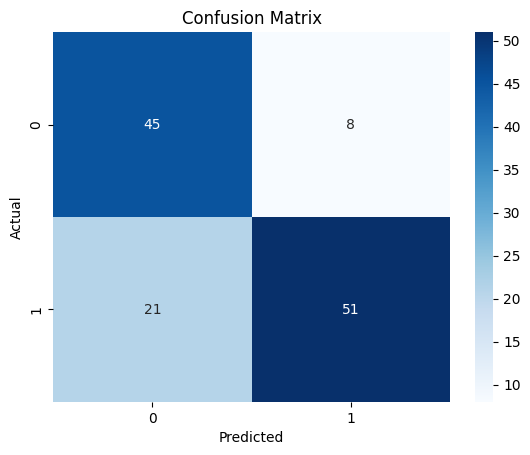

Confusion Matrix:
[[45  8]
 [21 51]]
Accuracy: 0.768
Precision: 0.864406779661017
Recall: 0.7083333333333334
F1 Score: 0.7786259541984732
True Labels: [0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 1 0 0 1 1 1 1 0 1 0 1 1 1 1 1 1 0 0 1 0 1 0
 0 0 1 0 0 0 0 1 0 1 0 1 1 1 0 0 1 1 0 1 0 0 0 0 1 0 1 1 0 1 0 1 1 1 1 0 1
 0 0 1 1 1 1 0 1 1 0 1 1 1 1 1 1 1 0 1 0 1 1 1 0 0 1 1 1 1 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 0 1 0 1 0 1 1 0]
Predictions: [0 0 0 1 0 0 0 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 0 1 1 1 1 0 1 1 1 0 0 1 0 1 1
 1 1 1 0 0 0 0 1 0 1 0 1 1 0 0 0 0 1 0 0 1 0 0 0 1 0 0 0 0 1 0 1 1 1 1 0 1
 0 0 1 1 1 1 0 1 0 0 1 0 0 0 0 1 1 1 0 1 1 0 0 0 0 1 1 1 1 0 0 0 0 1 1 0 0
 1 1 0 1 0 1 0 1 0 1 0 0 1 0]


In [ ]:
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Convertir listas a numpy arrays
true_labels = np.array(true_labels)
predictions = np.array(predictions)

# Calcular la matriz de confusión
conf_matrix = confusion_matrix(true_labels, predictions)

# Calcular indicadores de rendimiento
accuracy = accuracy_score(true_labels, predictions)
precision = precision_score(true_labels, predictions)
recall = recall_score(true_labels, predictions)
f1 = f1_score(true_labels, predictions)

# Mostrar la matriz de confusión
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues")
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

# Imprimir la matriz de confusión y los indicadores de rendimiento
print("Confusion Matrix:")
print(conf_matrix)
print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")

# Mostrar los resultados binarios recolectados
print("True Labels:", true_labels)
print("Predictions:", predictions)


Tu modelo muestra una mejora constante tanto en la pérdida de entrenamiento como en la pérdida de validación a lo largo de las épocas. Sin embargo, dado que el proceso de entrenamiento parece ser bastante largo, podrías considerar algunos ajustes para optimizarlo. Aquí hay algunas sugerencias:

Patience para EarlyStopping: Actualmente tienes patience=15 para el callback de EarlyStopping. Dado que la pérdida de validación parece mejorar de manera constante, podrías reducir ligeramente este valor a alrededor de 10. Esto podría detener el entrenamiento antes si la mejora se detiene.

Factor de Reducción de la Tasa de Aprendizaje: El ReduceLROnPlateau tiene un factor de reducción de 0.5. Esto parece adecuado, pero asegúrate de que tu tasa de aprendizaje mínima (min_lr) esté configurada, para que no se reduzca demasiado y el entrenamiento se vuelva ineficiente. Puedes añadirlo así:

python
Copiar código
plateau = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.5, patience=5, verbose=1, min_lr=1e-6
)
Incrementar el tamaño del lote (Batch Size): Si tienes suficiente memoria GPU, podrías intentar incrementar el tamaño del lote, lo que podría acelerar el entrenamiento.

Número de Épocas: Observando tu historial, parece que después de aproximadamente 60 épocas, la pérdida de validación mejora muy poco. Podrías reducir el número máximo de épocas a 60 y ajustar patience y ReduceLROnPlateau en consecuencia.

Graficar la Pérdida: Es una buena práctica observar las curvas de pérdida para asegurarte de que no haya sobreajuste. Continúa graficando la pérdida de entrenamiento y validación.

Aquí está el código ajustado:

python
Copiar código
# True if we want to train the model
if True:
    # Training the model
    plateau = tf.keras.callbacks.ReduceLROnPlateau(
      monitor='val_loss', factor=0.5, patience=5, verbose=1, min_lr=1e-6
    )
    es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', verbose=1,
                                          patience=10)  # Reduced patience
    save_best = tf.keras.callbacks.ModelCheckpoint(output_model_filepath, monitor='val_loss', save_best_only=True,
                                                mode='min', save_weights_only=True)  # Saves the best version of the model to disk (as measured on the validation data set)

    history = as_model.fit(train_datagen,
        epochs=60,  # Reduced number of epochs
        validation_data=validation_datagen,
        shuffle=True,
        callbacks=[es, save_best, plateau])
    
    # Training history
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'validation'], loc='upper left')
    plt.show()

    as_model.load_weights(output_model_filepath)
    as_model.compute_threshold(train_datagen)
    as_model.save_weights(output_model_filepath)
else:

    as_model.build((None, *INPUT_SIZE, 3))
    as_model.load_weights(input_model_filepath)
    as_model.compute_threshold(train_datagen)
    as_model.summary()
    as_model.autoencoder.summary()
Prueba estos ajustes y observa si se logra una convergencia más rápida y eficiente. Además, es importante monitorear siempre las curvas de pérdida para asegurarse de que el modelo esté aprendiendo correctamente sin sobreajustarse.